# Validation on weekly Thinking Machines Data

Main Details:
- Comparison of GAN imputation vs other interpolation/imputation methods
- Thinking Machines Davao City dengue data with 40% missing rate
- Including cosine distance and Linfoot's criteria

In [ ]:
import pandas as pd
import numpy as np
import os
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.impute import KNNImputer
from collections import defaultdict
import re
from sklearn.metrics import r2_score

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
#Data
folder_path = "/content/drive/My Drive/IPL-VIP/GAN Plots/SPP/saved_plot_data"
csv_files = [file for file in os.listdir(folder_path) if file.endswith('.csv')]

#Folder
output_dir = os.path.join('/content/drive/My Drive/IPL-VIP/', 'Thesis Plots')
poster_dir = os.path.join('/content/drive/My Drive/IPL-VIP/', 'Thesis Plots/Poster')
os.makedirs(poster_dir, exist_ok=True)
os.makedirs(output_dir, exist_ok=True)


# --- Interpolation methods ---
interpolation_methods = {
    'Linear': {'method': 'linear'},
    #'Polynomial (2nd order)': {'method': 'polynomial', 'order': 2},
    'Polynomial (3rd order)': {'method': 'polynomial', 'order': 3},
    #'Polynomial (5th order)': {'method': 'polynomial', 'order': 5},
    'Spline cubic': {'method': 'spline', 'order': 3},
    'Mean': {'method': 'mean'},
    'KNN': {'method': 'knn'},
}

#Functions
def extract_gap_and_trial(filename):
    gap_match = re.search(r'gap_(\d+)', filename)
    trial_match = re.search(r'trial_(\d+)', filename)
    gap = int(gap_match.group(1)) if gap_match else None
    trial = int(trial_match.group(1)) if trial_match else None
    return gap, trial


def calculate_angle(vector_a, vector_b):
    """
    Calculate the cosine of the angle between two vectors using the dot product formula.

    Parameters:
    - vector_a: The first vector
    - vector_b: The second vector

    Returns:
    - cos(theta): The cosine of the angle between the two vectors
    """

    #Normalize the vectors to unit vectors
    norm_a = np.linalg.norm(vector_a)
    norm_b = np.linalg.norm(vector_b)

    unit_vector_a = vector_a / norm_a
    unit_vector_b = vector_b / norm_b

    #Compute the dot product and cosine of the angle
    dot_product = np.dot(unit_vector_a, unit_vector_b)
    return dot_product

def get_continuous_segments(indices):
    """Group consecutive indices into continuous segments."""
    if len(indices) == 0:
        return []

    segments = []
    start = indices[0]
    prev = indices[0]

    for i in indices[1:]:
        if i == prev + 1:
            prev = i
        else:
            segments.append(np.arange(start, prev + 1))
            start = i
            prev = i
    segments.append(np.arange(start, prev + 1))
    return segments


def calculate_linfoot(gt_segment, imp_segment):
    eps = 1e-8
    gt_mismatch = gt_segment
    imp_mismatch = imp_segment
    ideal_squared_mean = np.mean(gt_mismatch ** 2) + eps
    F = 1 - np.mean((gt_mismatch - imp_mismatch) ** 2) / ideal_squared_mean
    C = np.mean(imp_mismatch ** 2) / ideal_squared_mean
    Q = np.mean(np.abs(gt_mismatch) * np.abs(imp_mismatch)) / ideal_squared_mean
    return F, C, Q

# Plotting all GAN


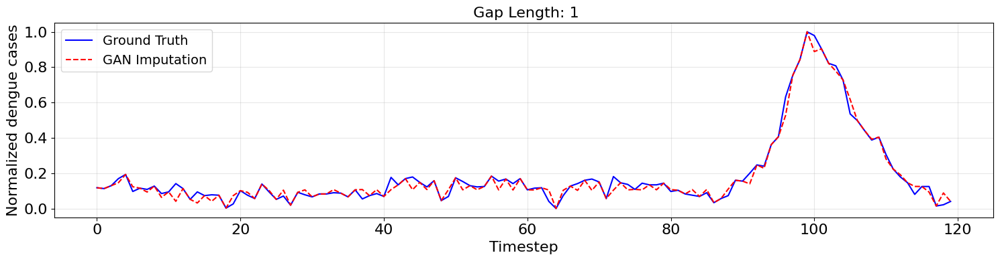

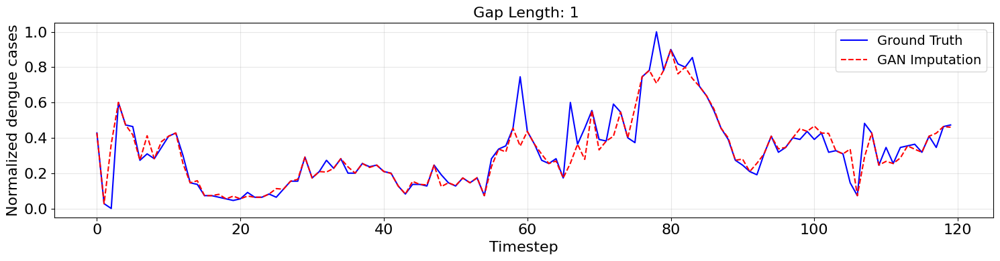

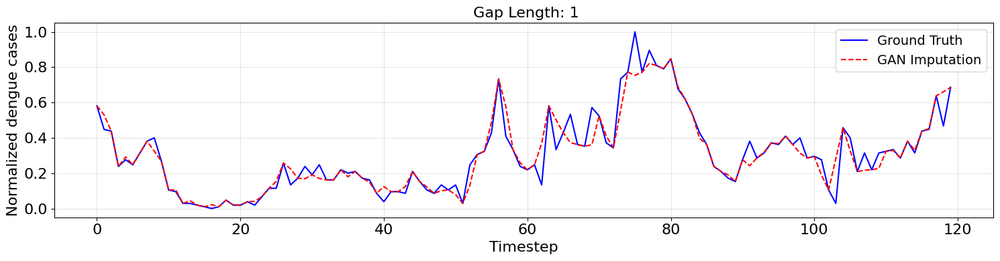

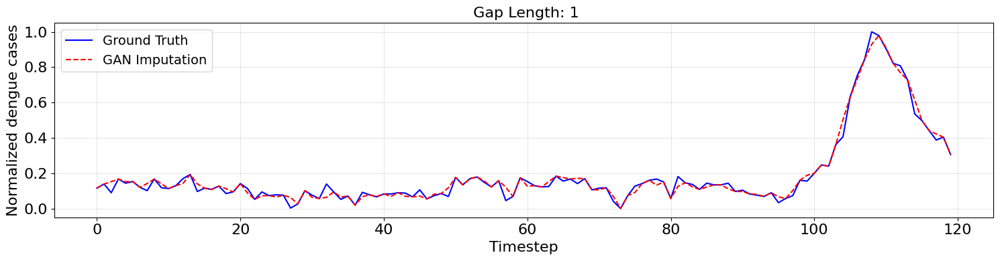

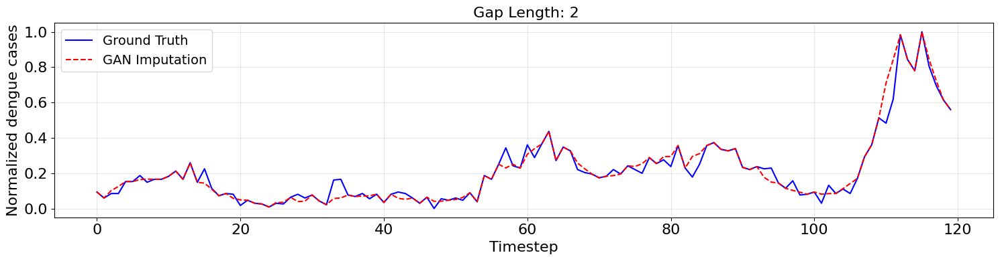

...

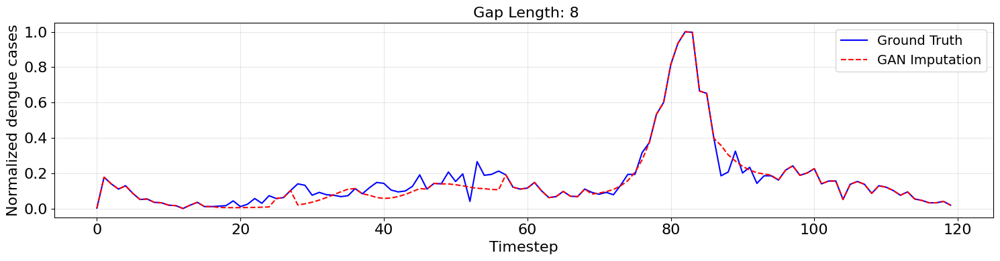

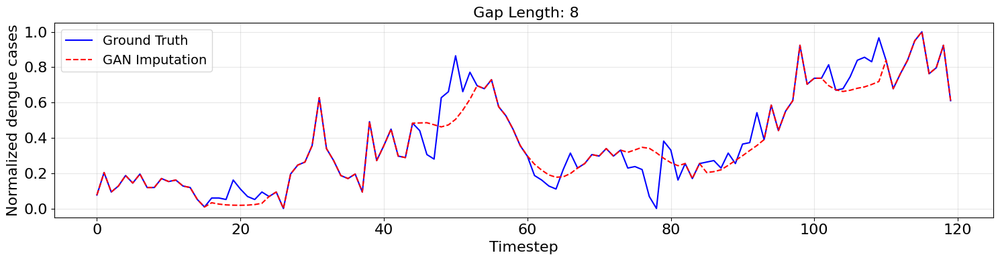

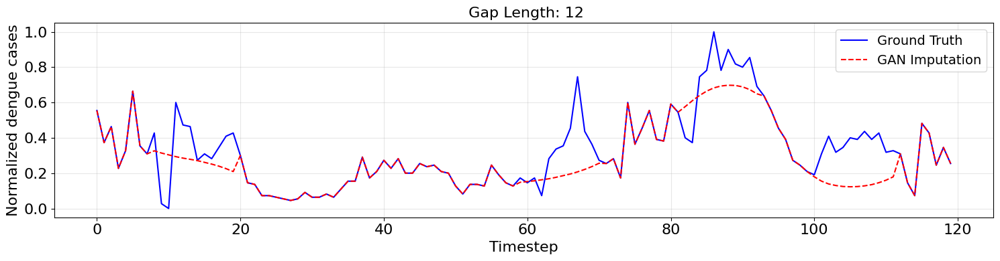

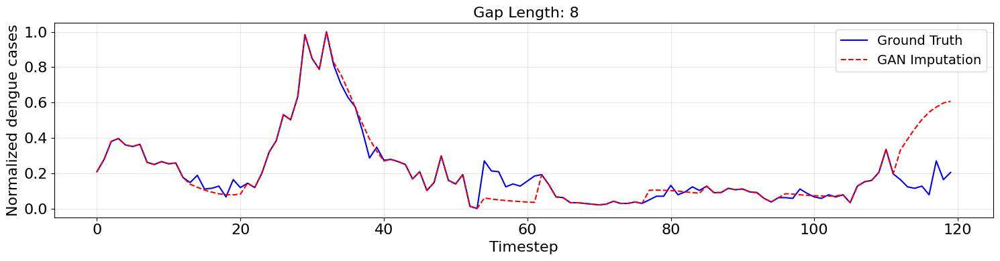

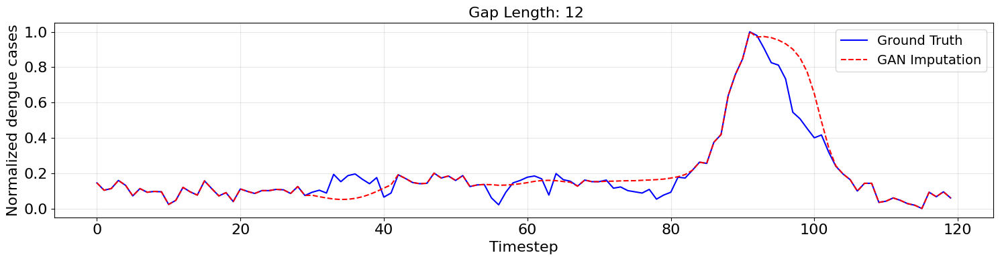

KeyboardInterrupt: 

In [ ]:
#Loop through each CSV file and plot
for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)

    #Assuming these columns exist in the CSV
    ground_truth = df['Ground Truth']
    imputed_filled = df['Imputed Data']

    gap_length, trial = extract_gap_and_trial(file)

    #Plotting
    plt.figure(figsize=(15, 4))
    plt.plot(ground_truth, label='Ground Truth', color='blue')
    plt.plot(imputed_filled, label=f"GAN Imputation", color='red', linestyle='--')
    plt.xlabel('Timestep', fontsize=16)
    plt.ylabel('Normalized dengue cases', fontsize=16)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.grid(alpha=0.3)
    #plt.title(f" Gaps: {gap_length} | Trial: {trial}")
    plt.title(f" Gap Length: {gap_length}", fontsize=16)
    plt.legend(fontsize=14)
    plt.tight_layout()
    comparison_filename = f'GAN_gap{gap_length}_t{trial}'
    comparison_path = os.path.join(output_dir, comparison_filename + '.png')
    #plt.savefig(comparison_path)
    plt.show()


In [ ]:
#Define allowed (gap_length, trial) pairs
gap_trial_map = {
    1: 3,
    2: 4,
    4: 2,
    6: 4,
    8: 1,
    16: 2,
    48: 2,
}

for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)

    ground_truth = df['Ground Truth']
    imputed_filled = df['Imputed Data']

    gap_length, trial = extract_gap_and_trial(file)

    #Skip if gap_length not in map or trial doesn't match
    if gap_length not in gap_trial_map or trial != gap_trial_map[gap_length]:
        continue

    fig, ax = plt.subplots(figsize=(8, 4))
    ax.plot(ground_truth, label='Ground Truth', color='blue')
    ax.plot(imputed_filled, label=f"GAN Imputation", color='red', linestyle='--')
    ax.set_xlabel('Timestep', fontsize=16)
    ax.set_ylabel('Normalized dengue cases', fontsize=16)
    ax.tick_params(axis='both', labelsize=16)
    ax.grid(alpha=0.3)
    ax.legend(fontsize=14)

    fig.text(0.01, 0.55, f'Gap Length: {gap_length}', fontsize=20, va='center', rotation='vertical')

    plt.tight_layout(rect=[0.03, 0, 1, 1])
    comparison_filename = f'GAN_gap{gap_length}_t{trial}'
    comparison_path = os.path.join(poster_dir, comparison_filename + '.png')
    #plt.savefig(comparison_path)
    plt.show()


In [ ]:
for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)

    ground_truth = df['Ground Truth']
    imputed_filled = df['Imputed Data']

    gap_length, trial = extract_gap_and_trial(file)

    #Plotting
    fig, ax = plt.subplots(figsize=(15, 4))
    ax.plot(ground_truth, label='Ground Truth', color='blue')
    ax.plot(imputed_filled, label=f"GAN Imputation", color='red', linestyle='--')
    ax.set_xlabel('Timestep', fontsize=16)
    ax.set_ylabel('Normalized dengue cases', fontsize=16)
    ax.tick_params(axis='both', labelsize=16)
    ax.grid(alpha=0.3)
    ax.legend(fontsize=14)

    fig.text(0.01, 0.55, f'Gap Length: {gap_length}', fontsize=20, va='center', rotation='vertical')

    plt.tight_layout(rect=[0.03, 0, 1, 1])
    comparison_filename = f'GAN_gap{gap_length}_t{trial}'
    comparison_path = os.path.join(output_dir, comparison_filename + '.png')
    #plt.savefig(comparison_path)
    plt.show()


# OTHER METHODS AND METRICS

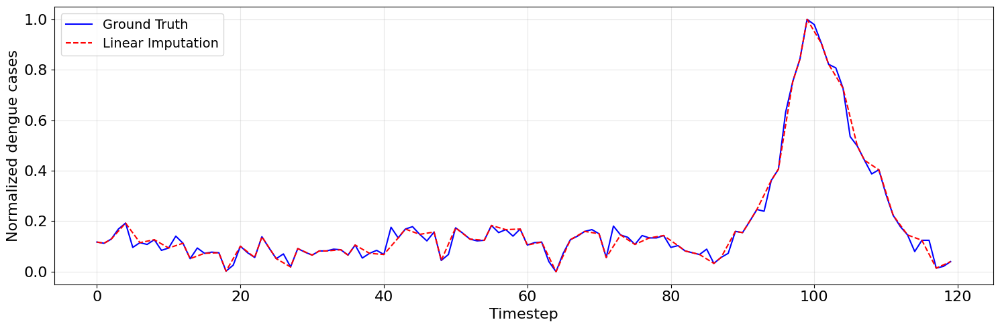

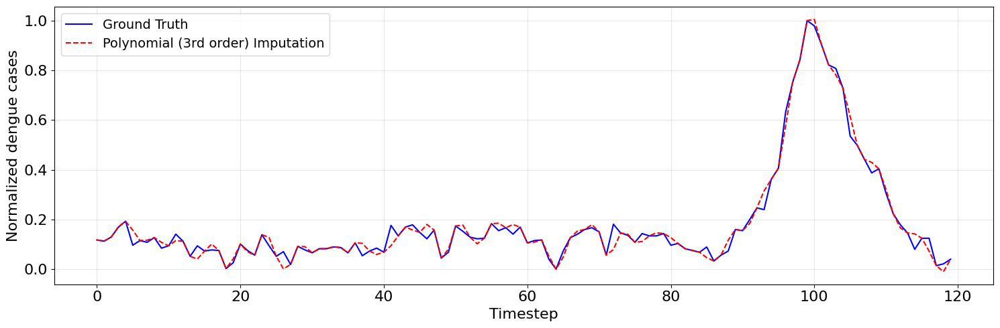

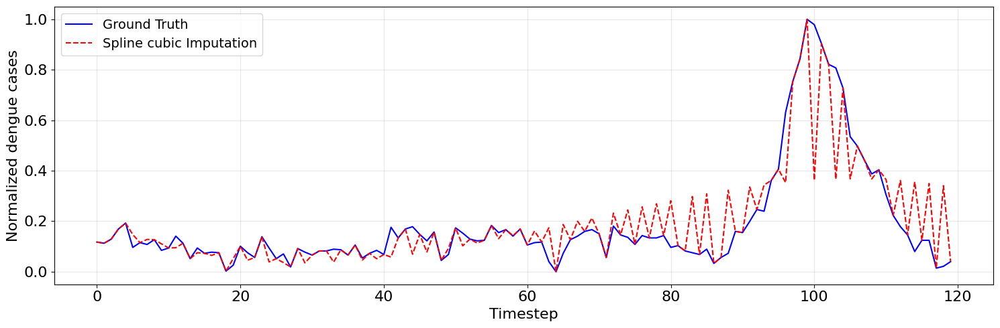

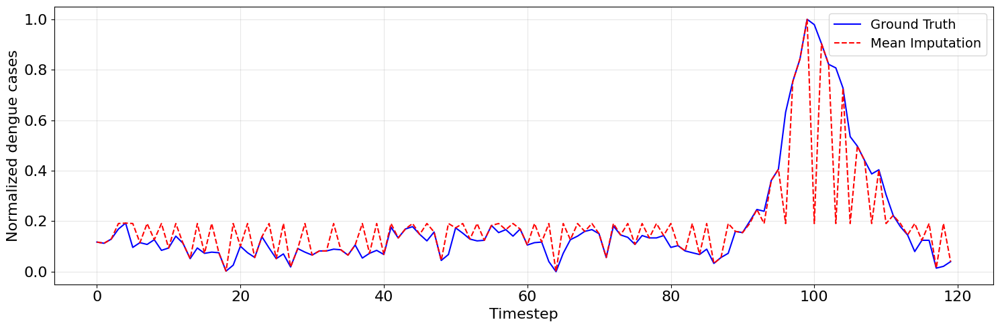

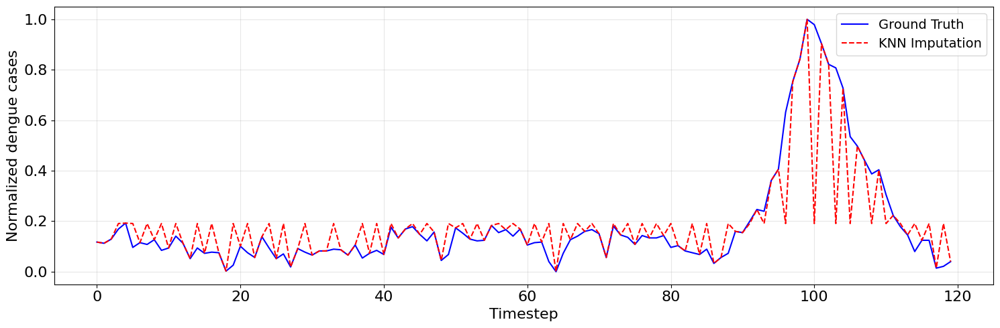

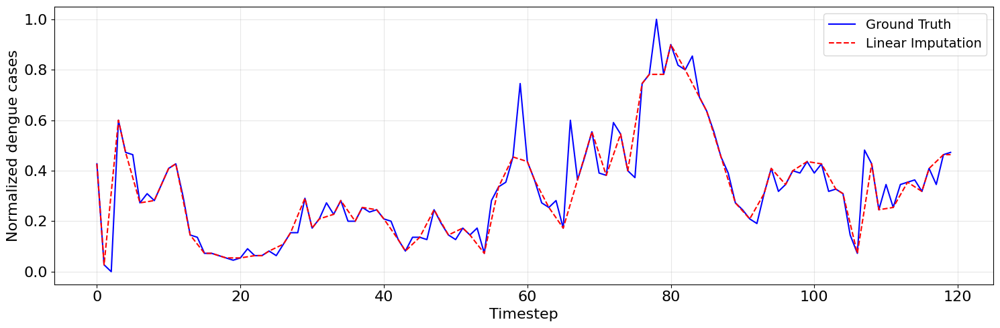

Error with Polynomial (3rd order) on gap_1_trial_1.csv: Input contains NaN.


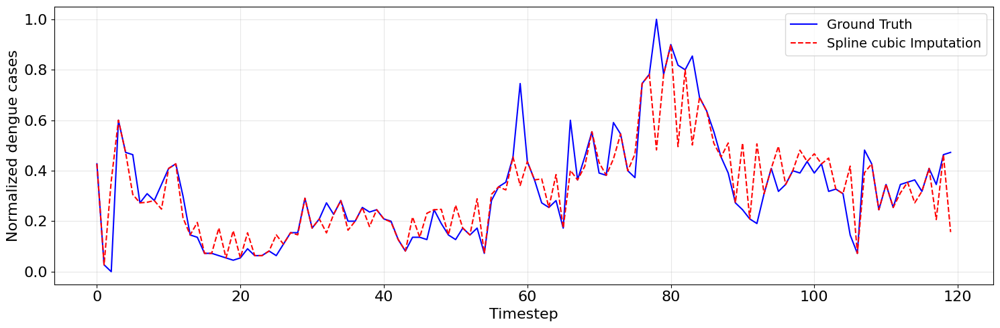

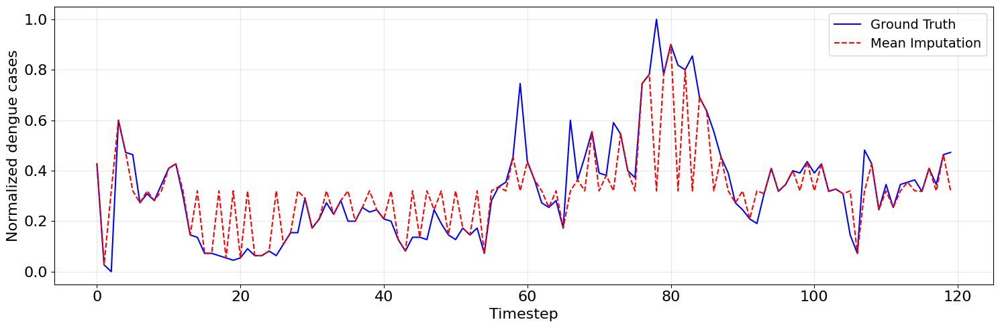

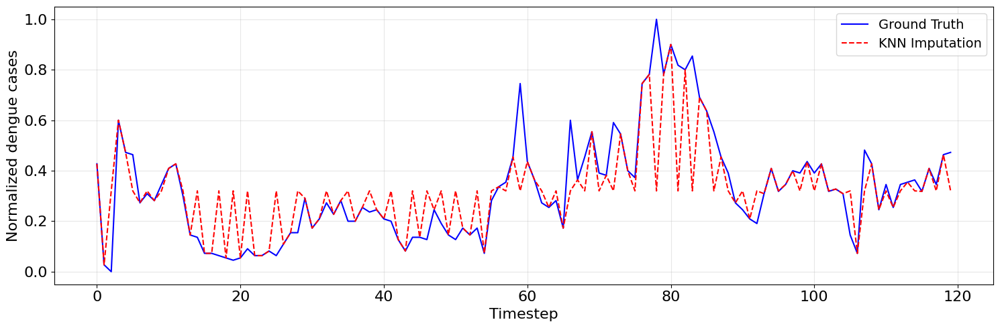

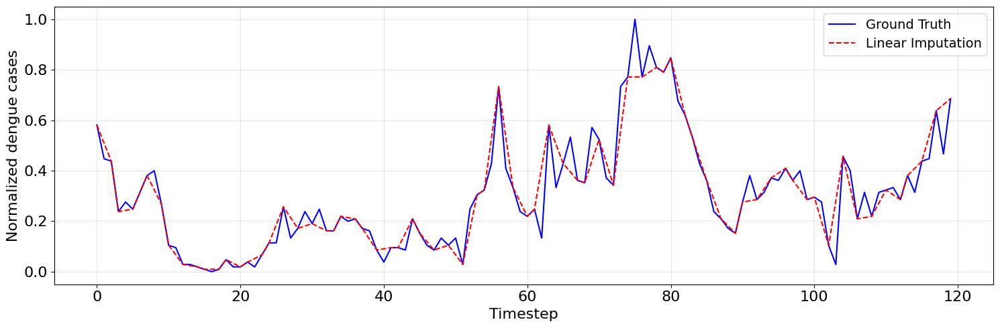

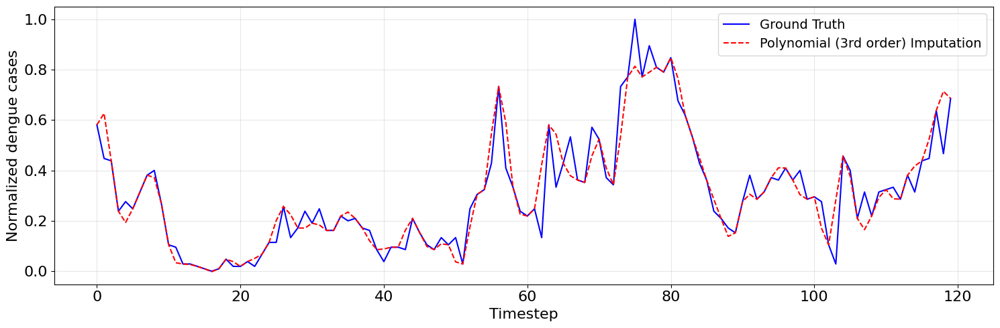

...

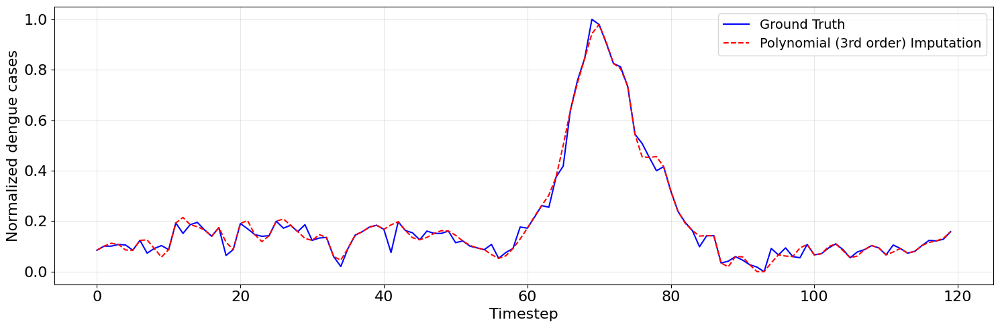

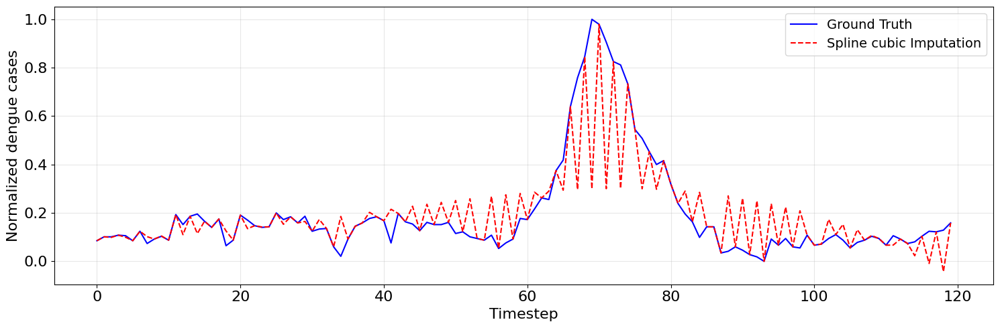

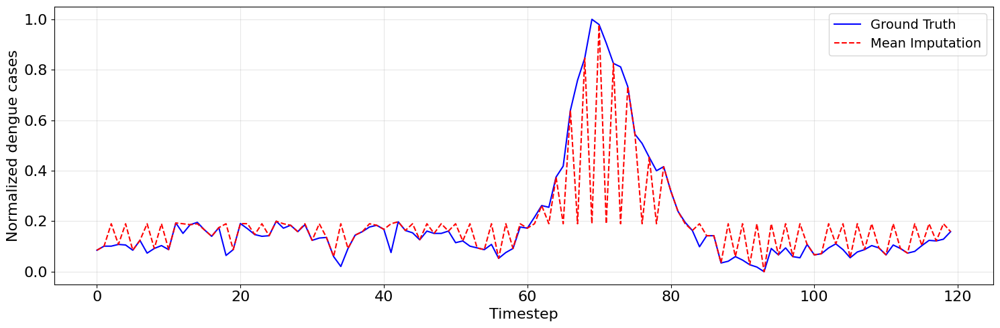

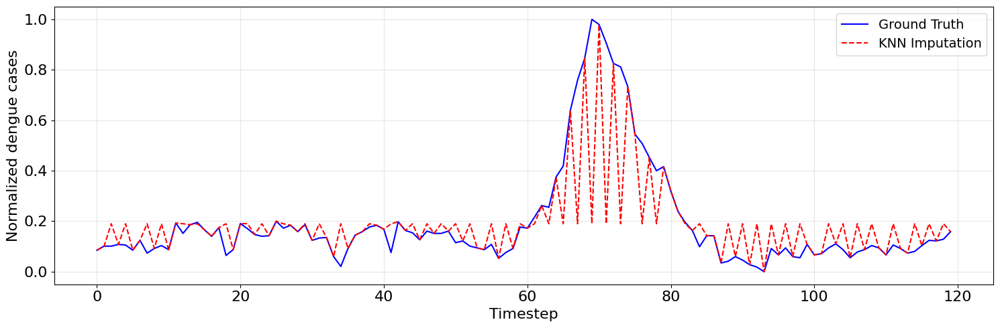

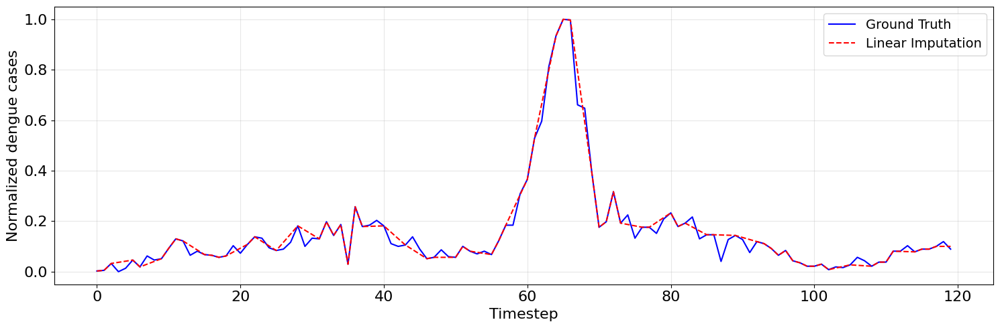

Error with Polynomial (3rd order) on gap_2_trial_2.csv: Input contains NaN.


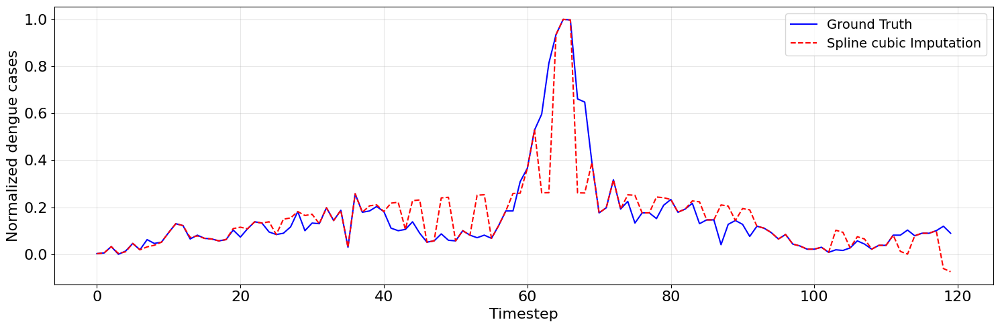

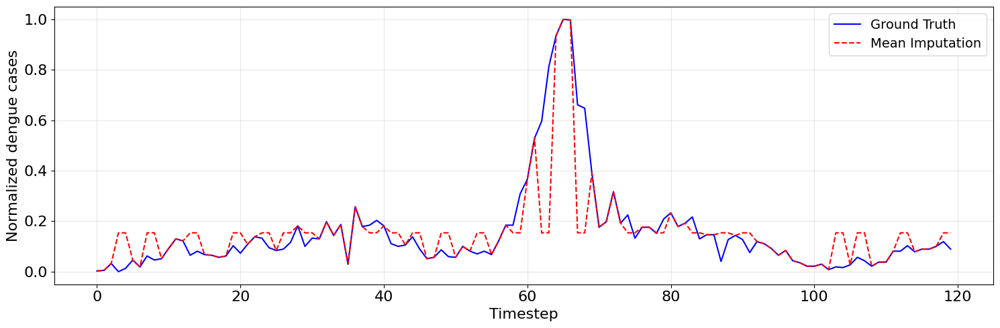

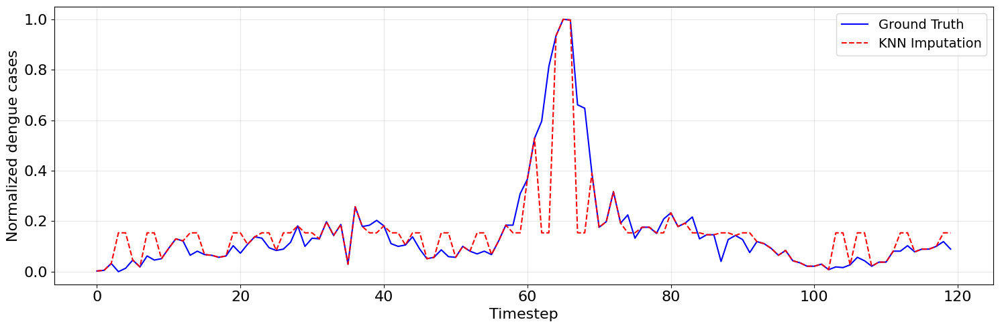

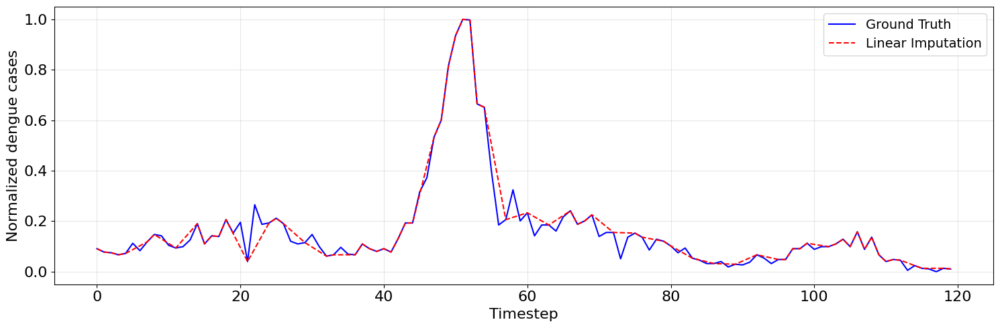

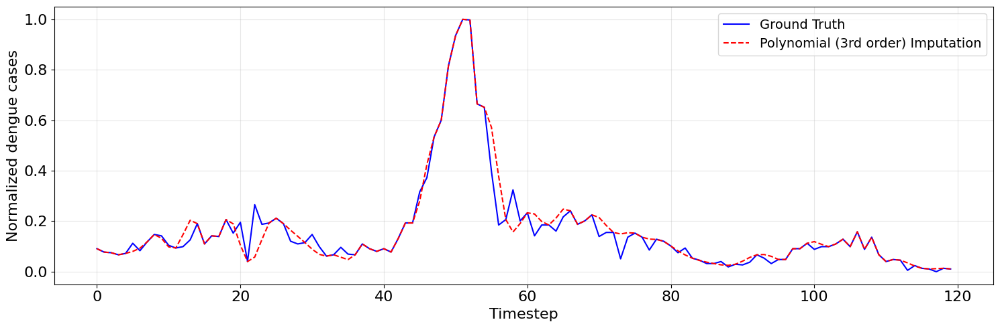

...

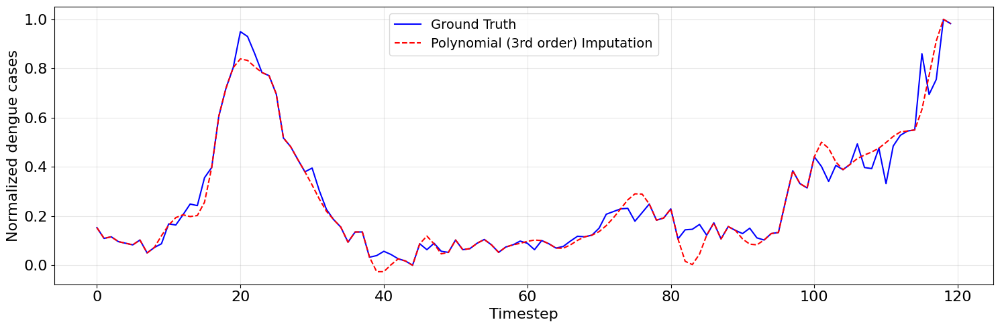

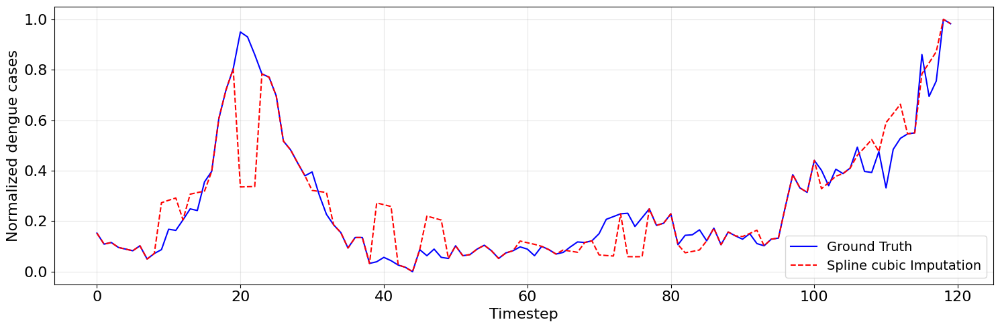

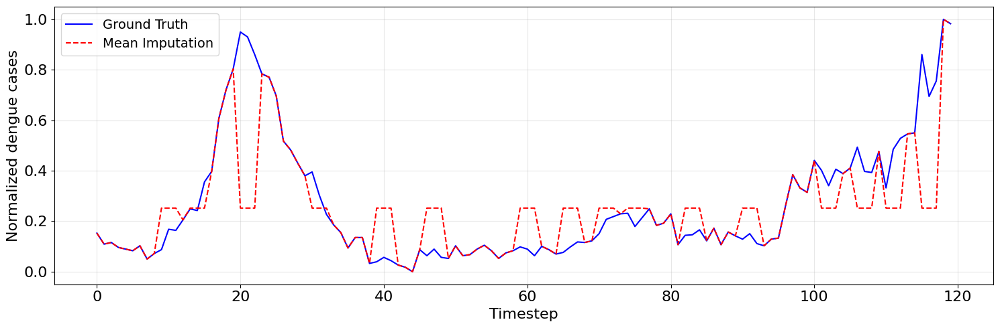

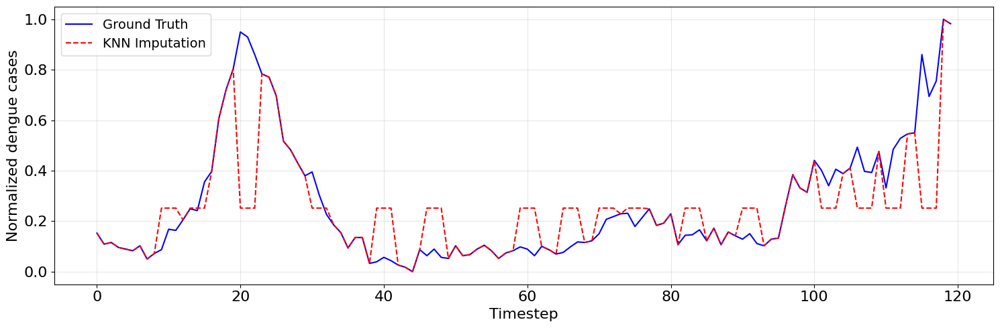

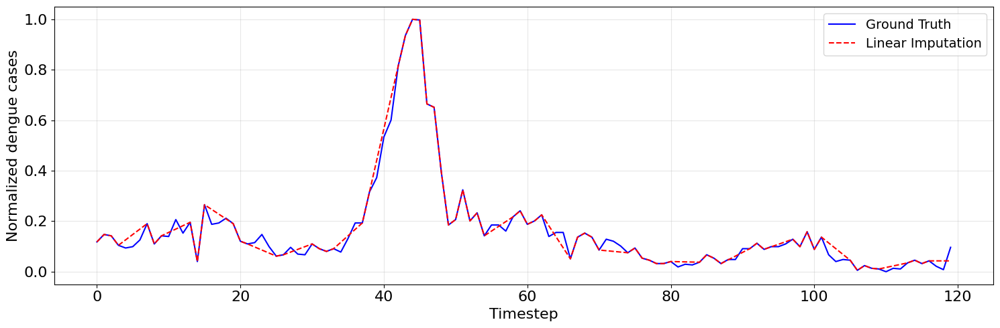

Error with Polynomial (3rd order) on gap_3_trial_3.csv: Input contains NaN.


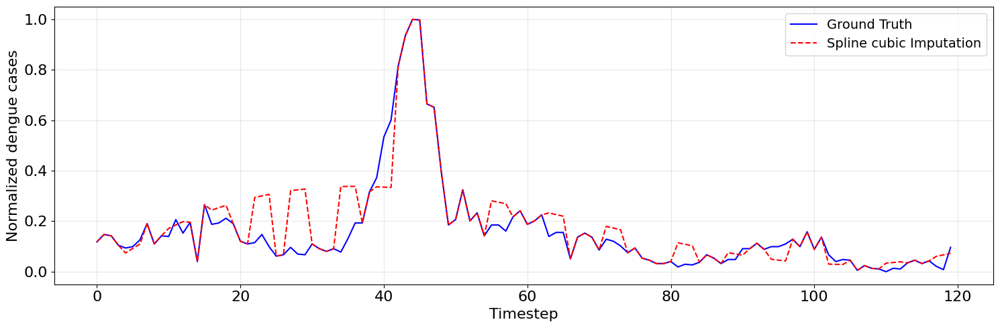

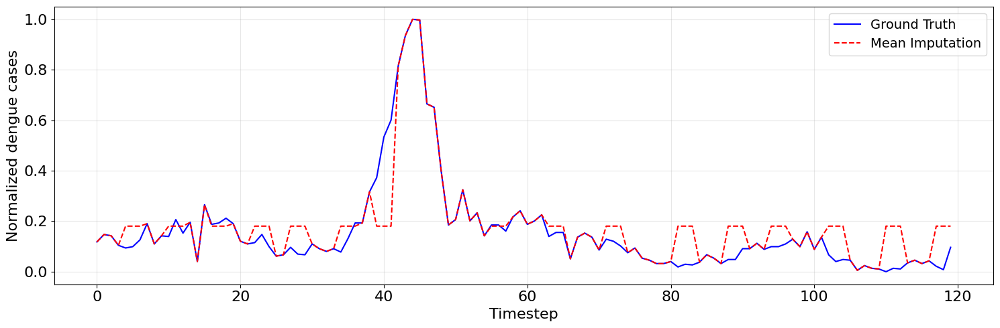

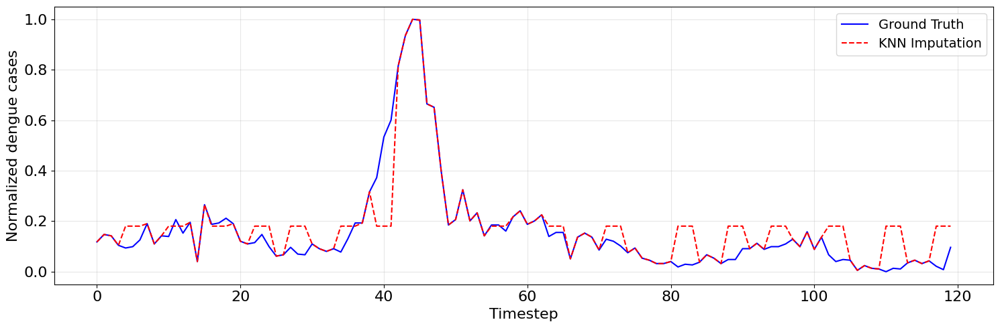

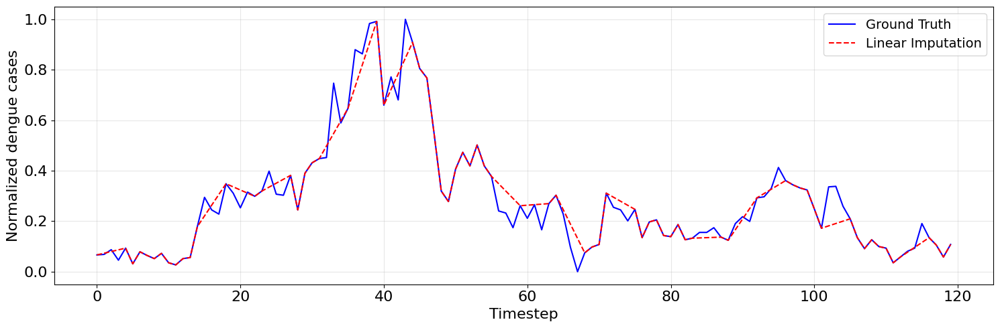

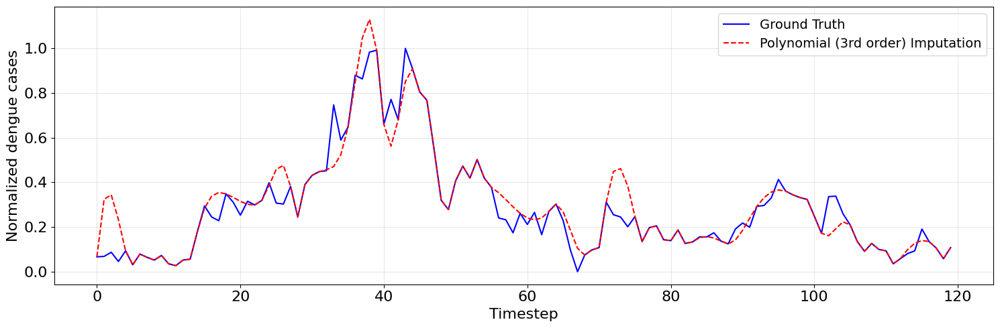

...

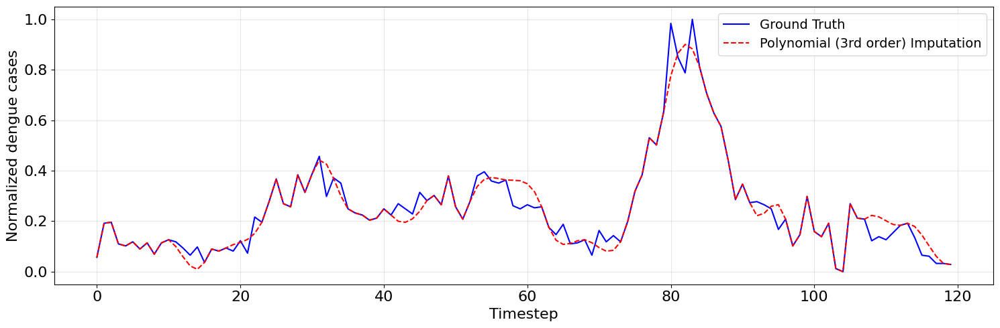

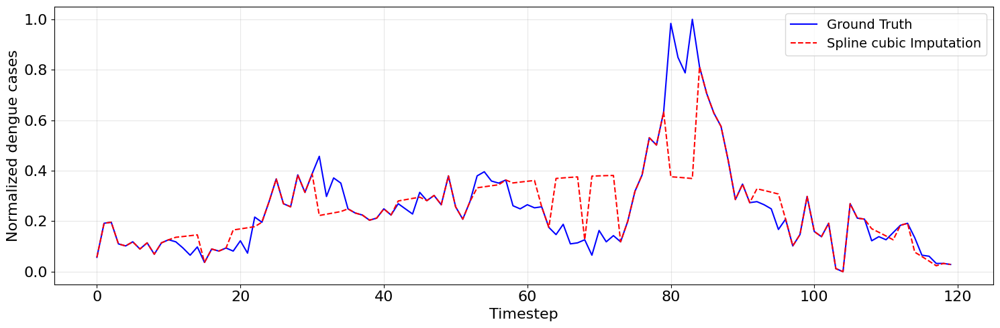

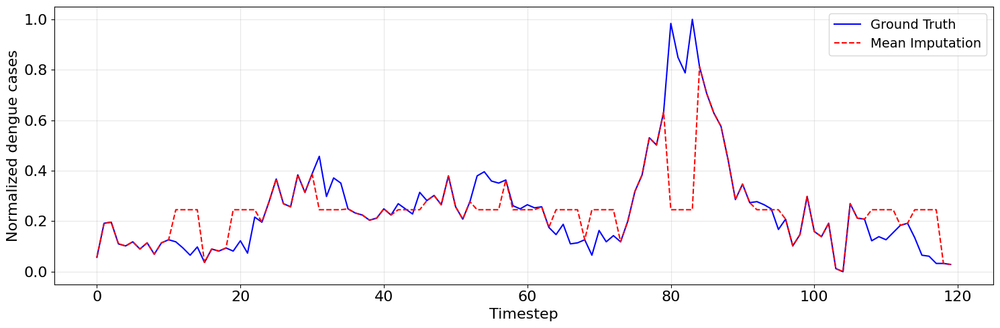

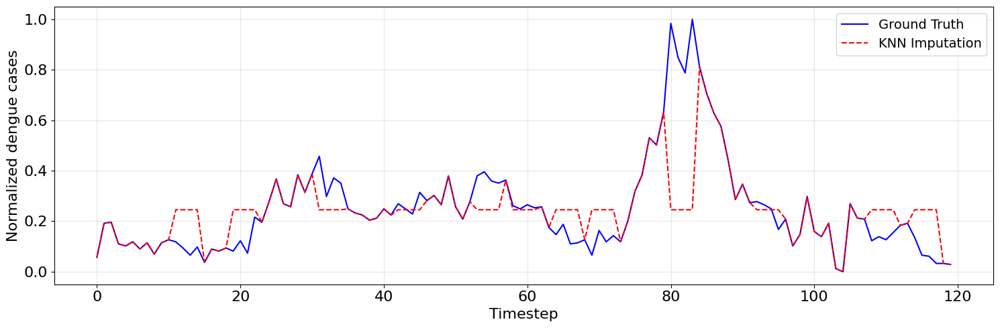

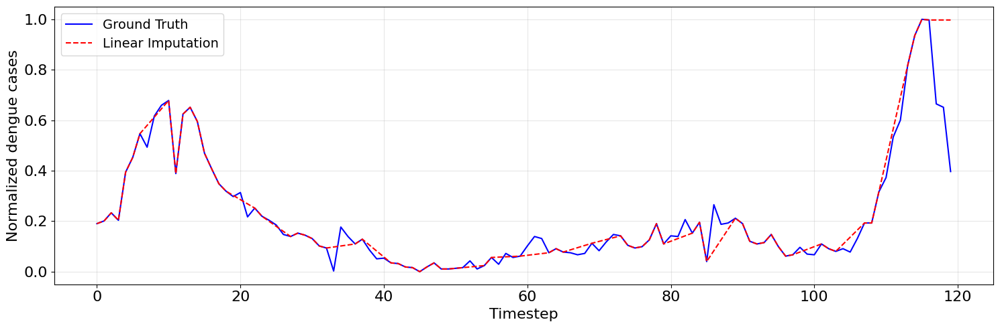

Error with Polynomial (3rd order) on gap_3_trial_5.csv: Input contains NaN.


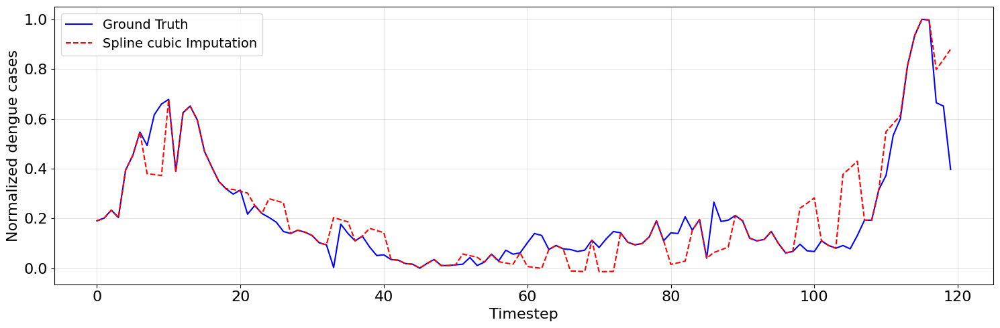

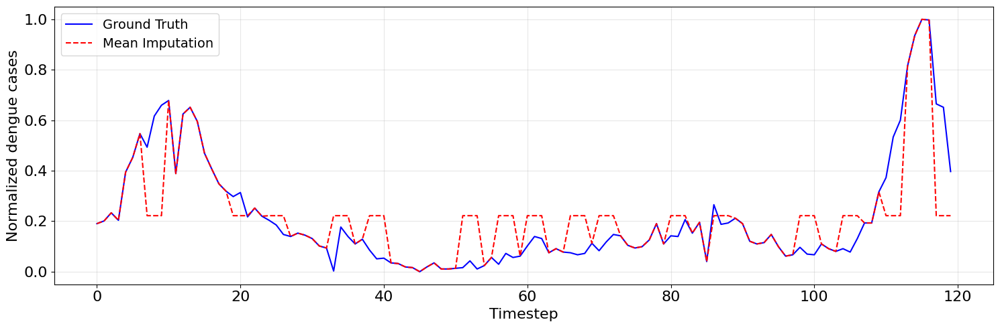

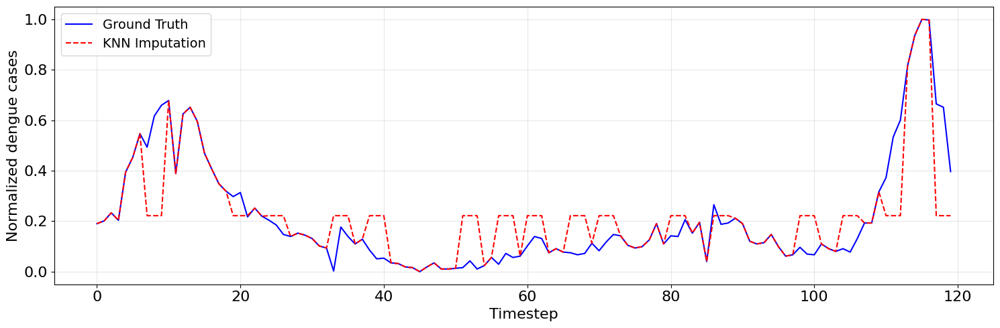

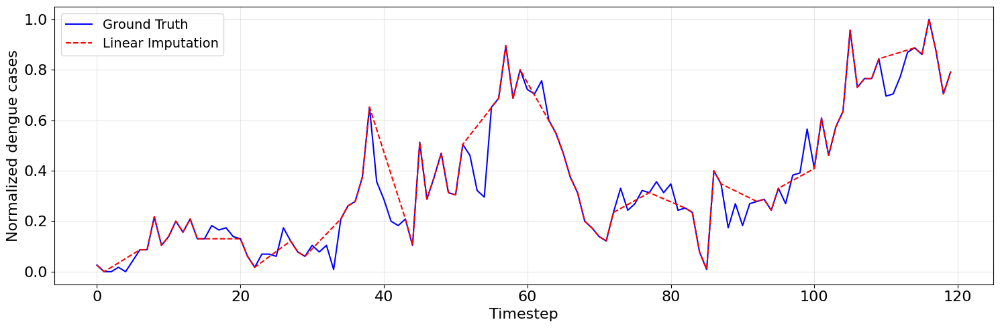

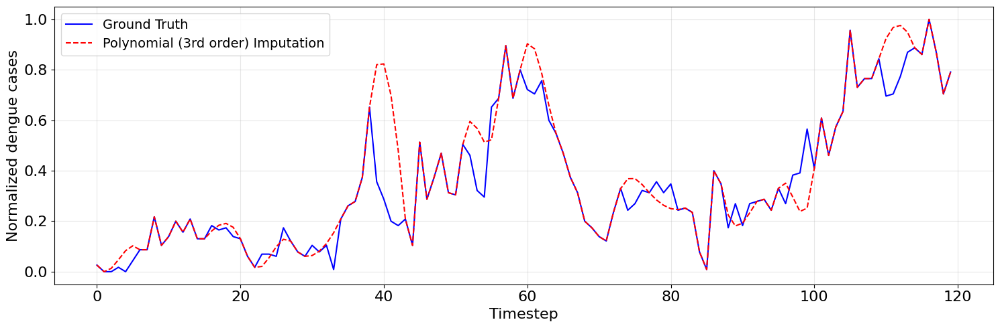

...

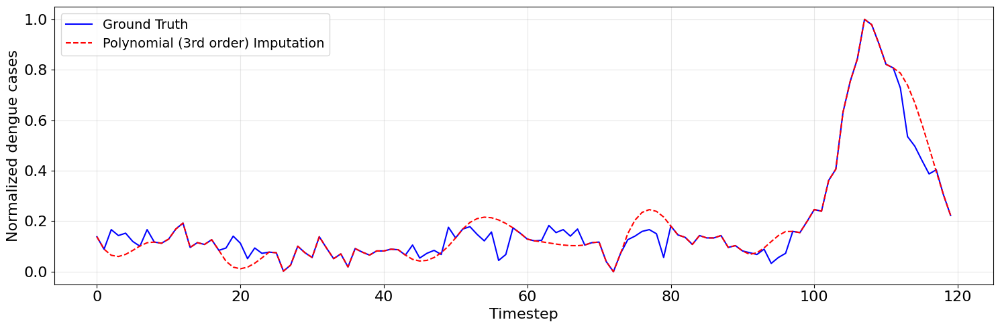

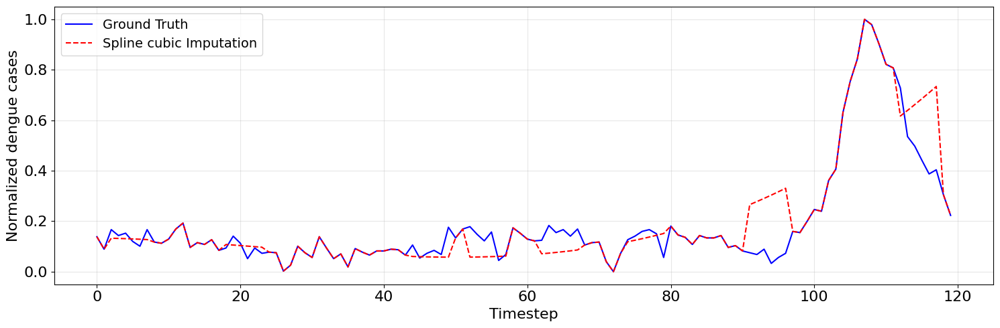

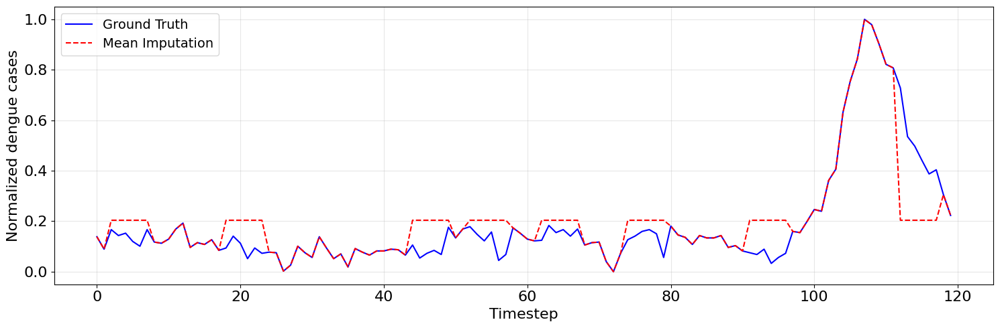

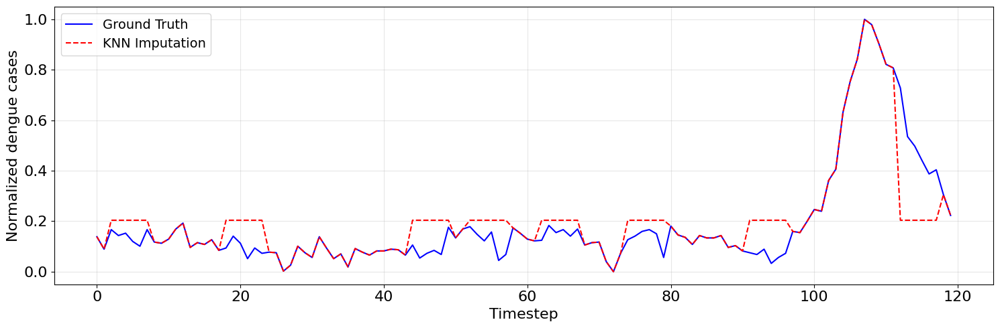

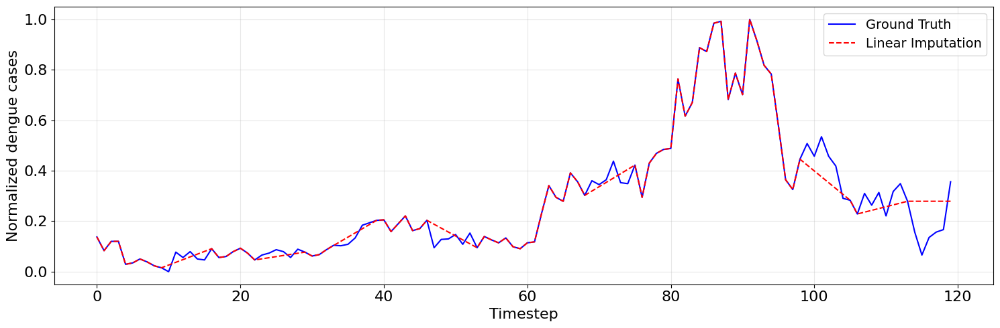

Error with Polynomial (3rd order) on gap_6_trial_5.csv: Input contains NaN.


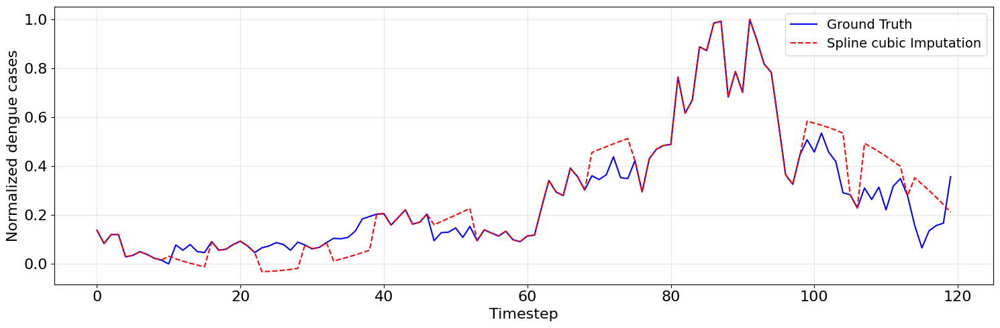

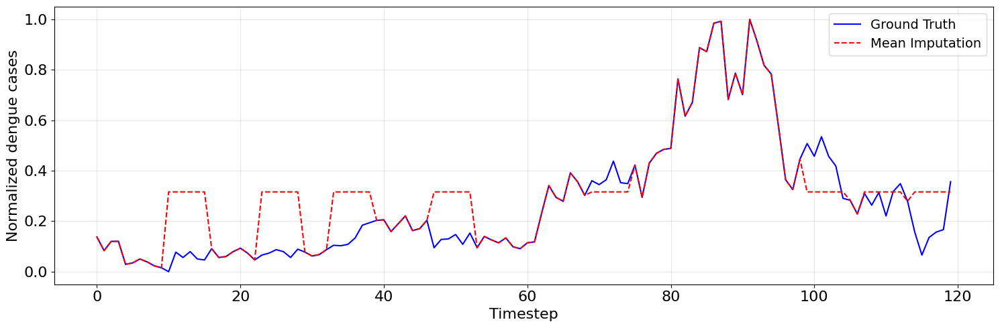

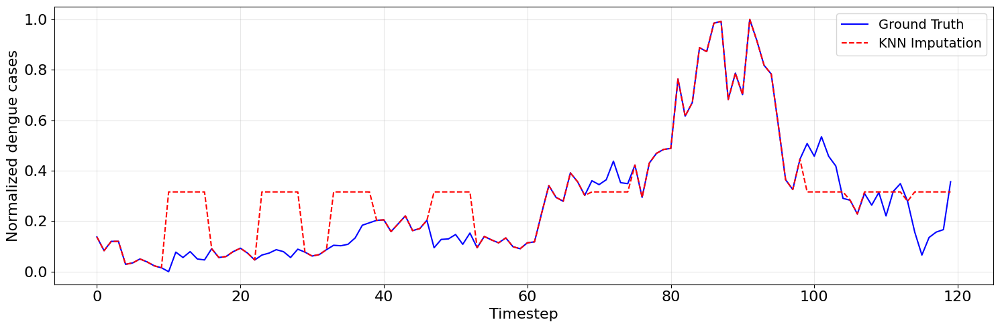

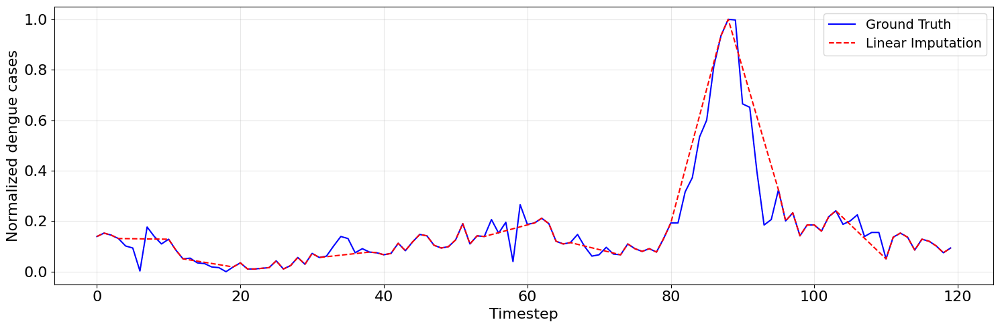

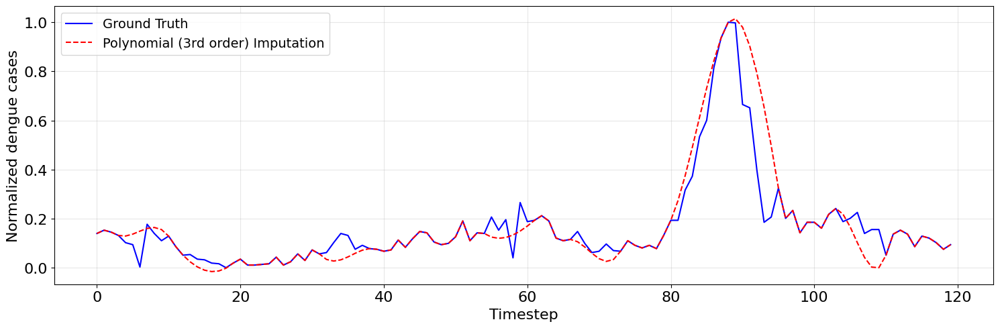

...

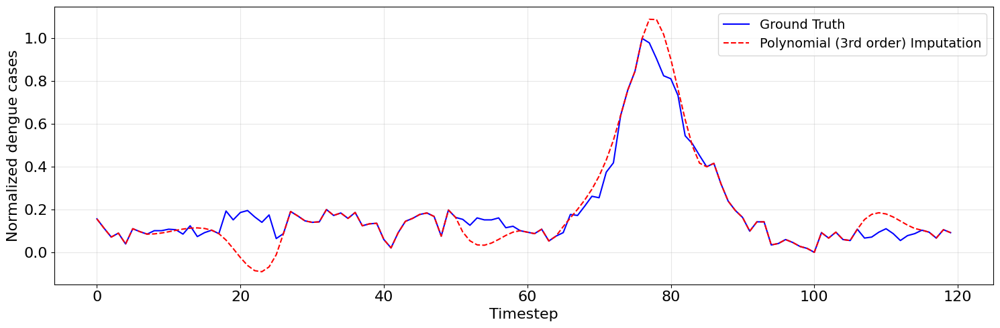

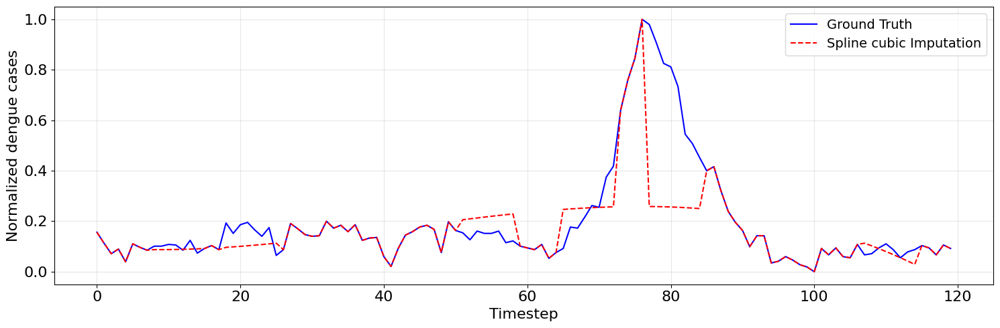

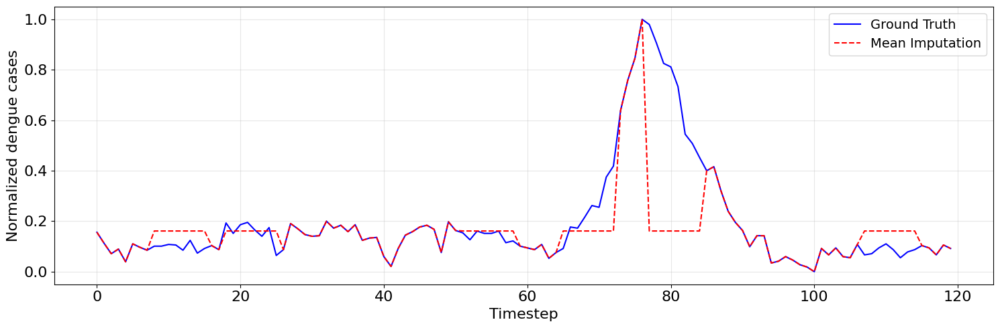

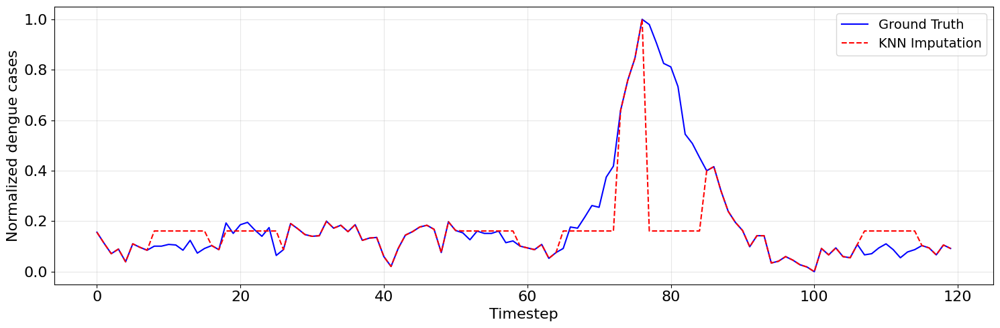

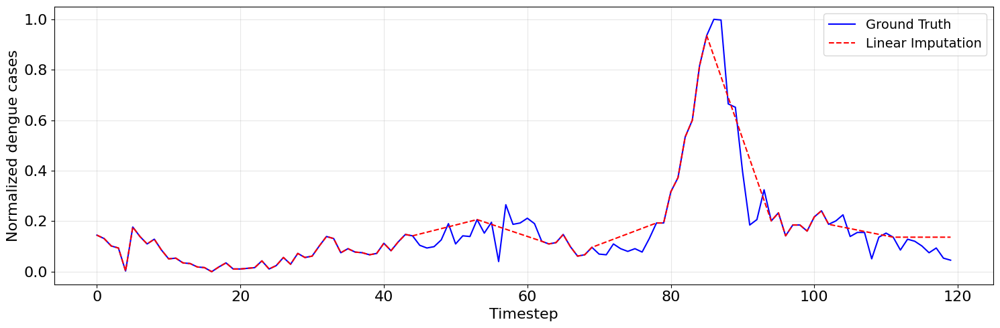

Error with Polynomial (3rd order) on gap_8_trial_3.csv: Input contains NaN.


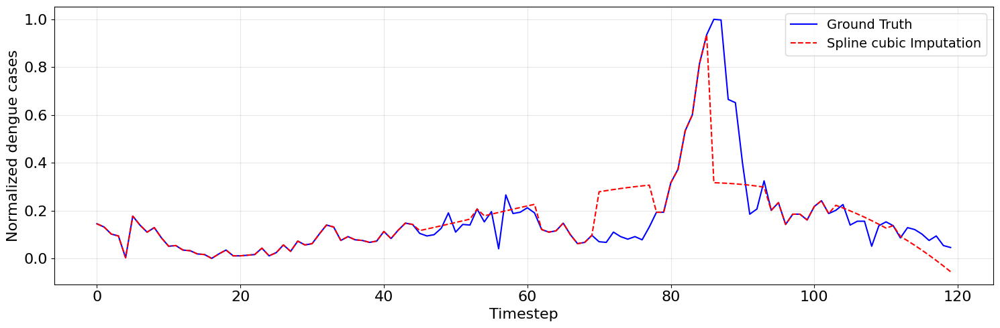

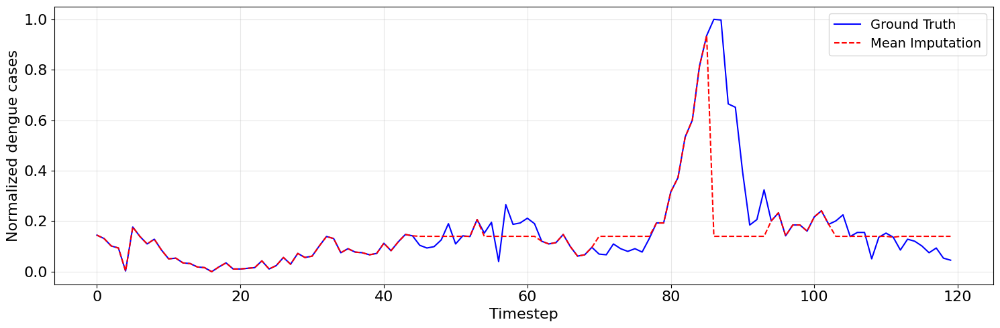

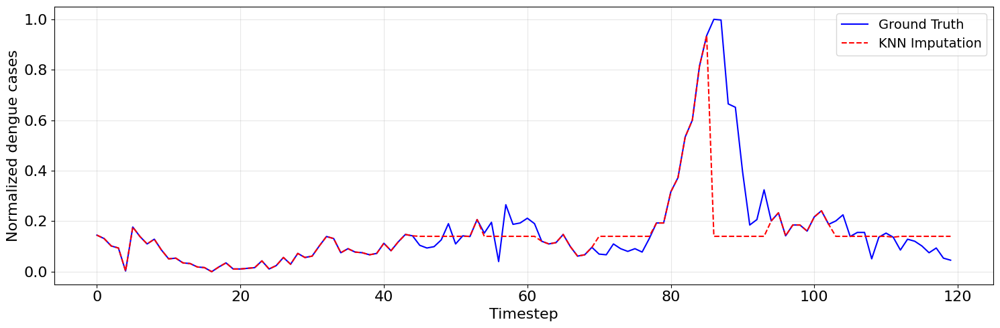

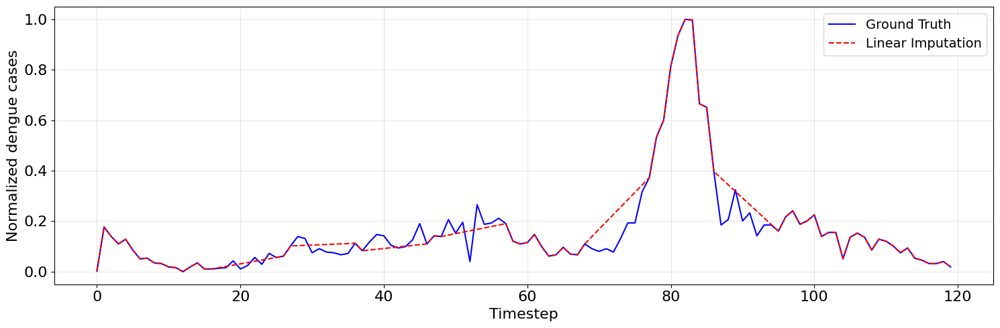

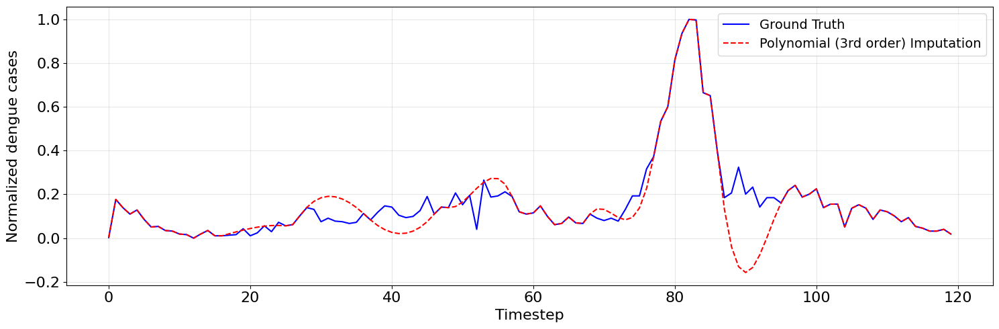

...

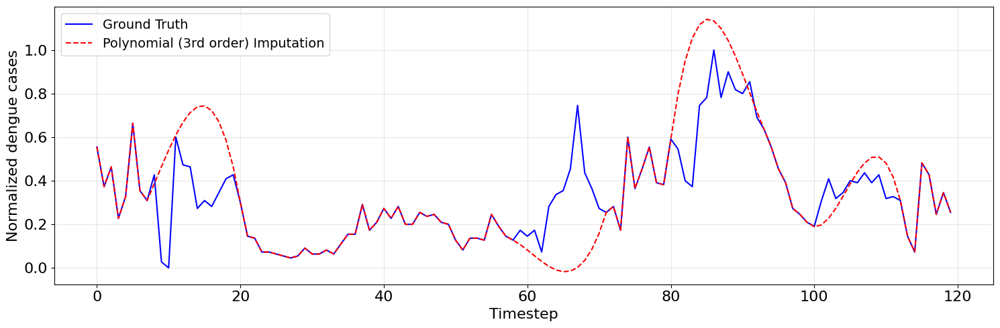

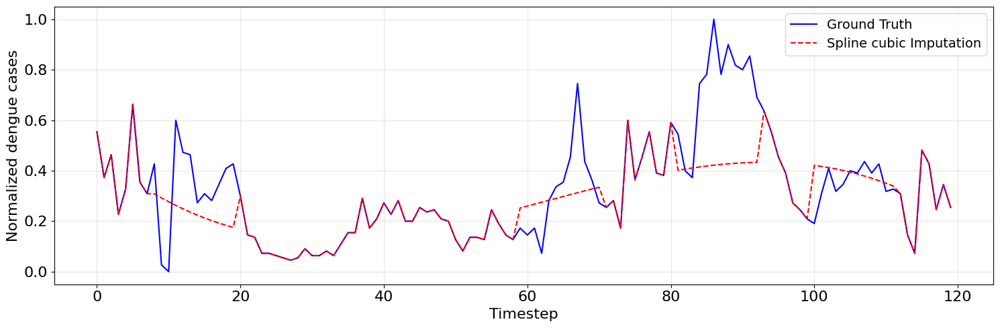

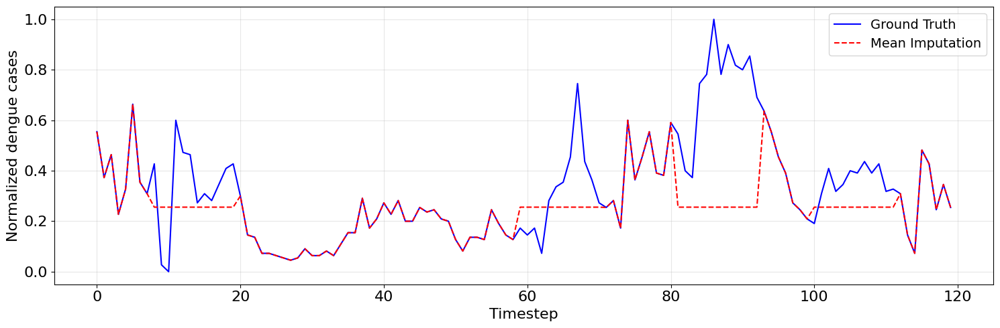

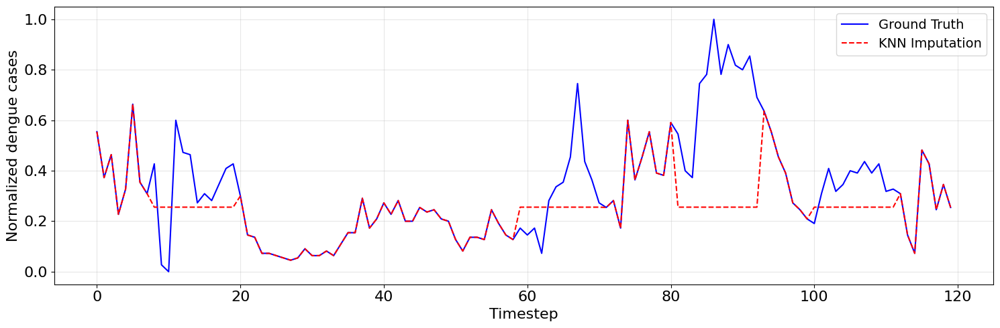

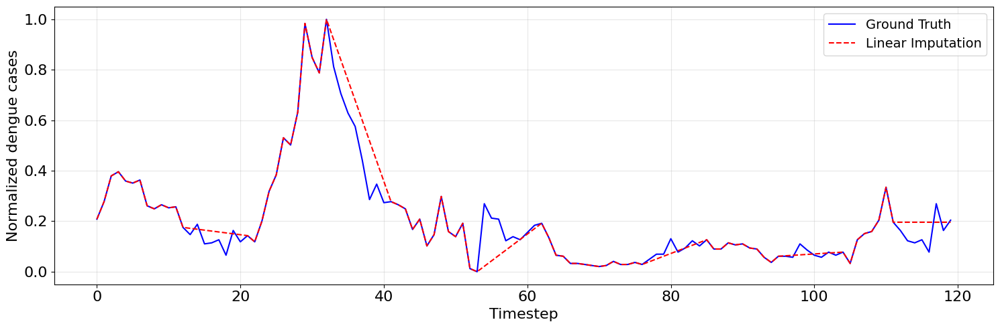

Error with Polynomial (3rd order) on gap_8_trial_5.csv: Input contains NaN.


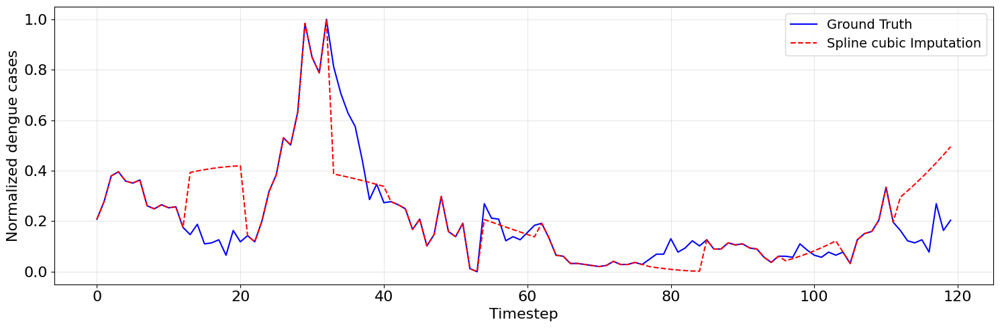

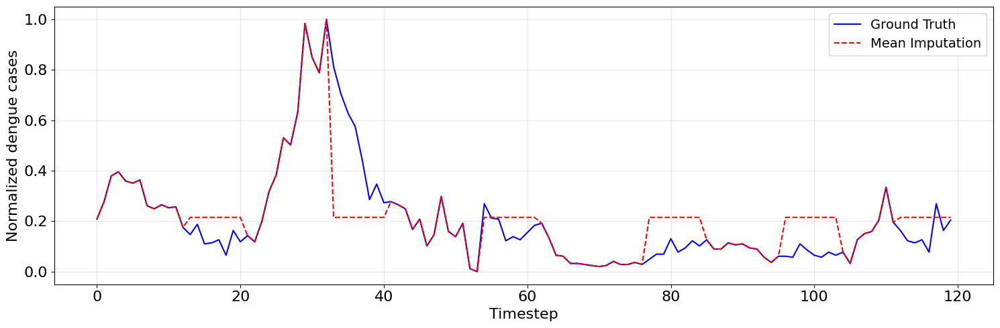

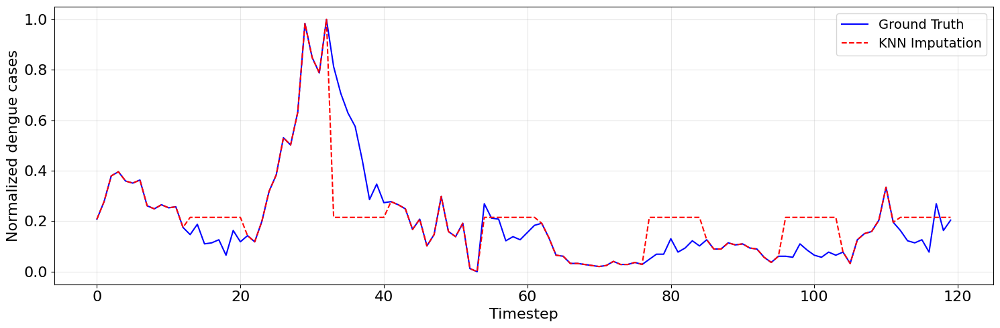

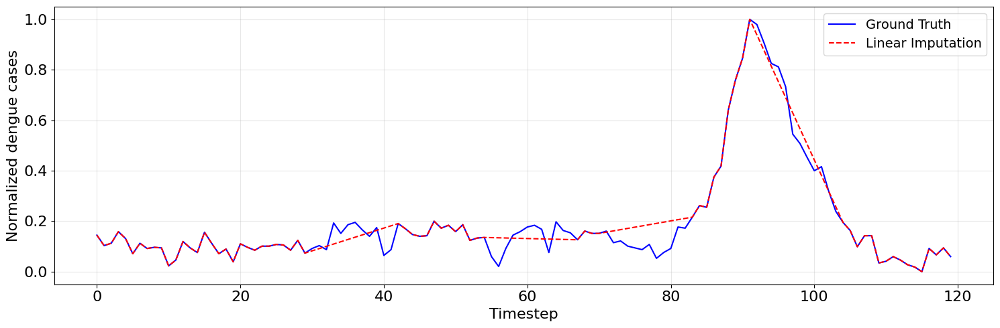

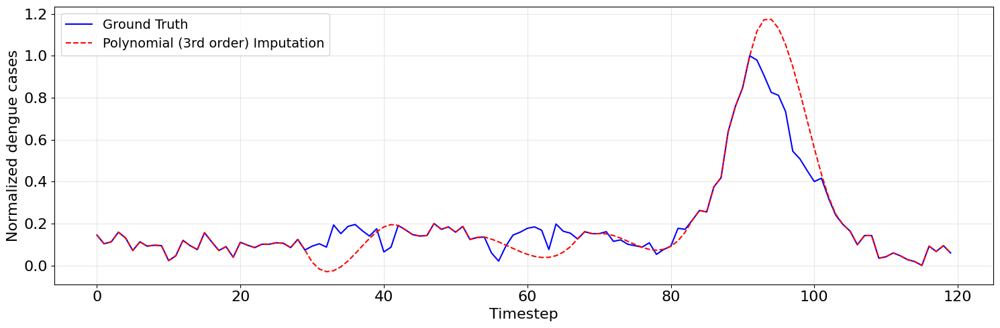

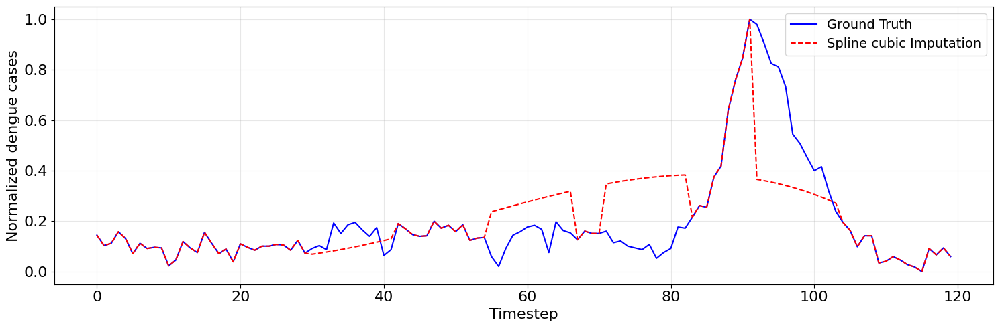

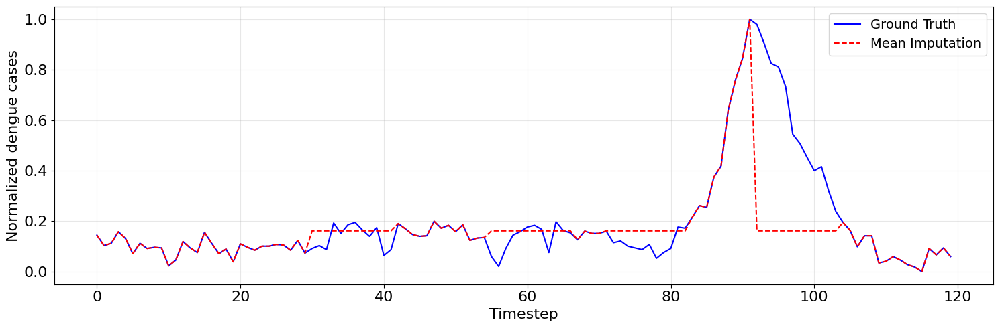

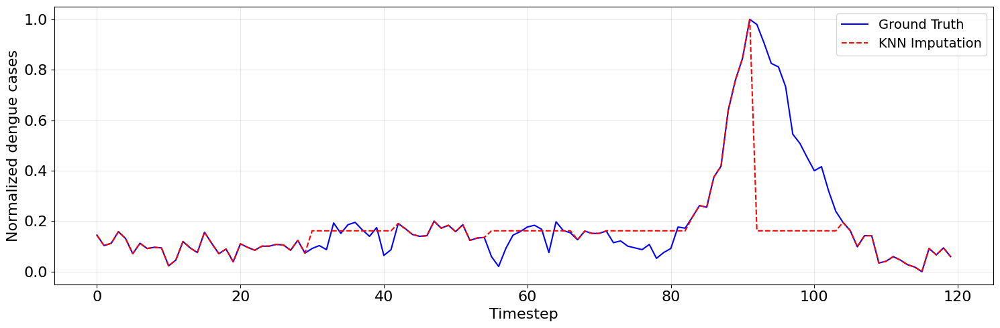

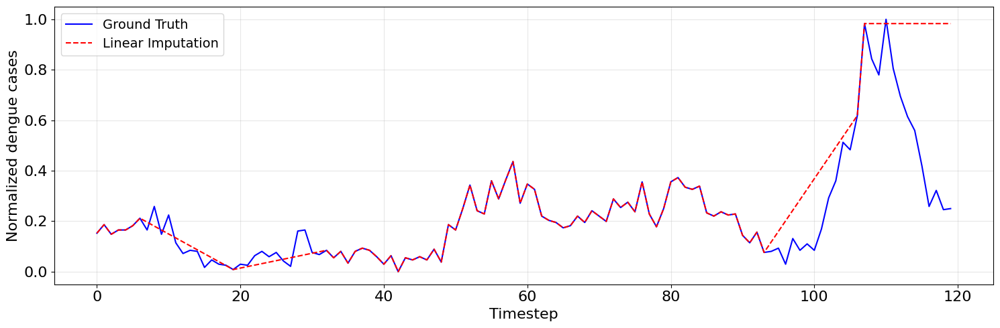

Error with Polynomial (3rd order) on gap_12_trial_2.csv: Input contains NaN.


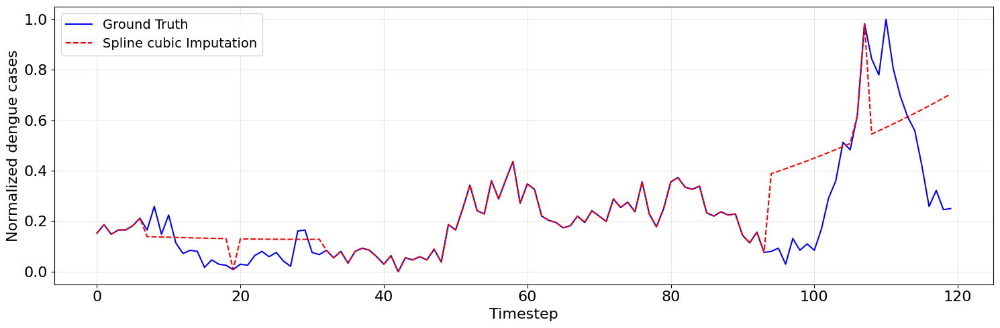

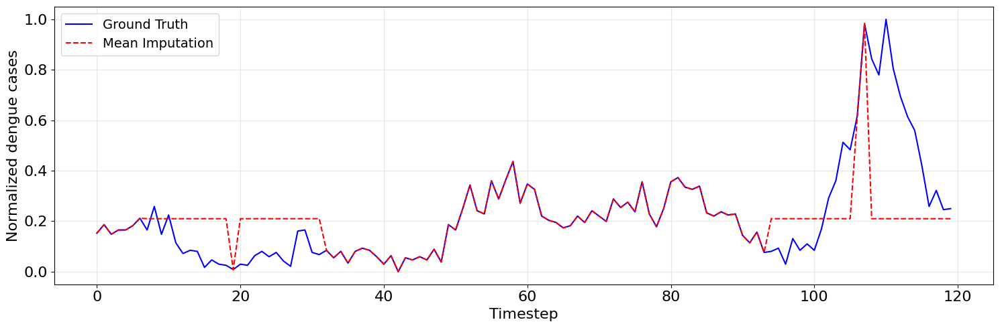

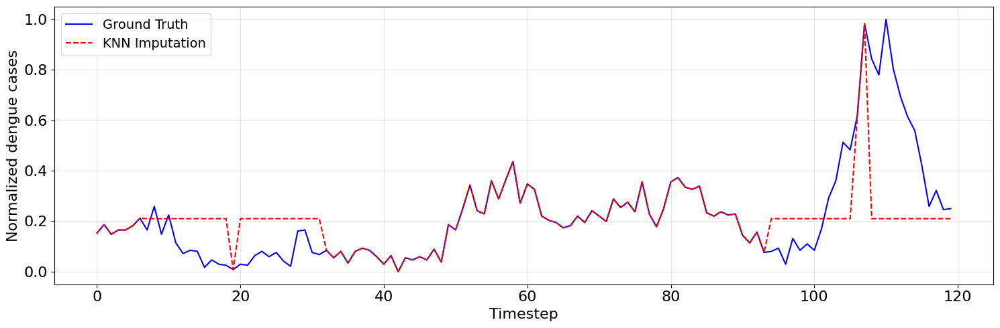

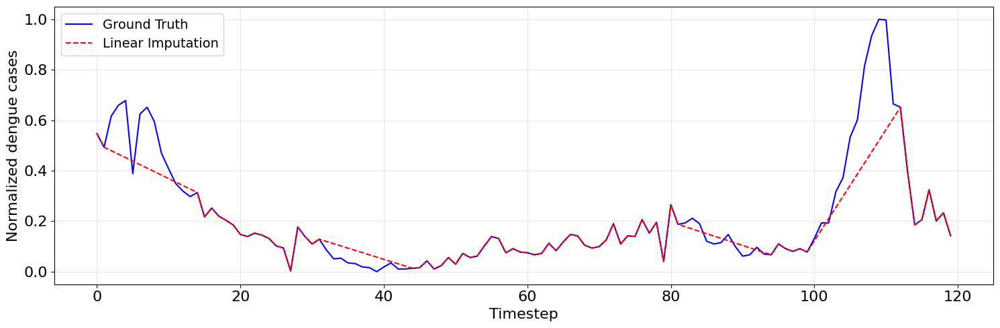

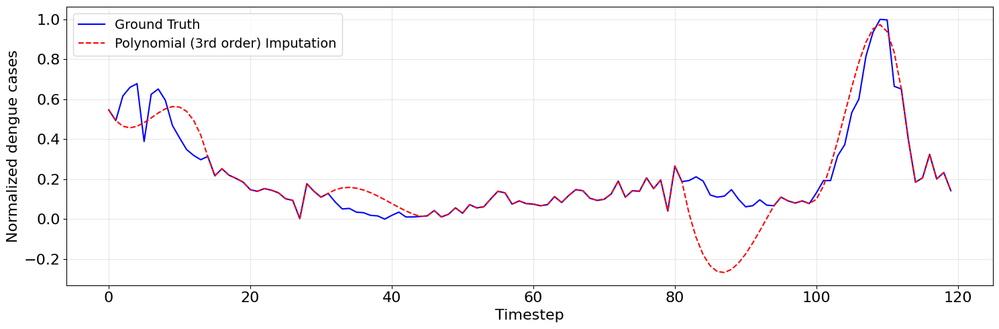

...

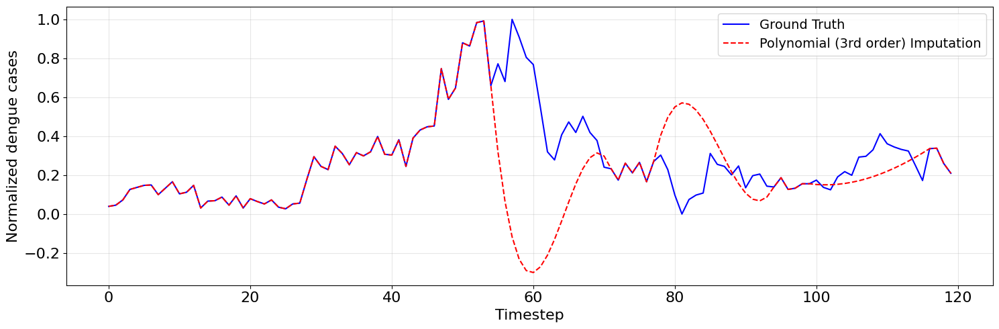

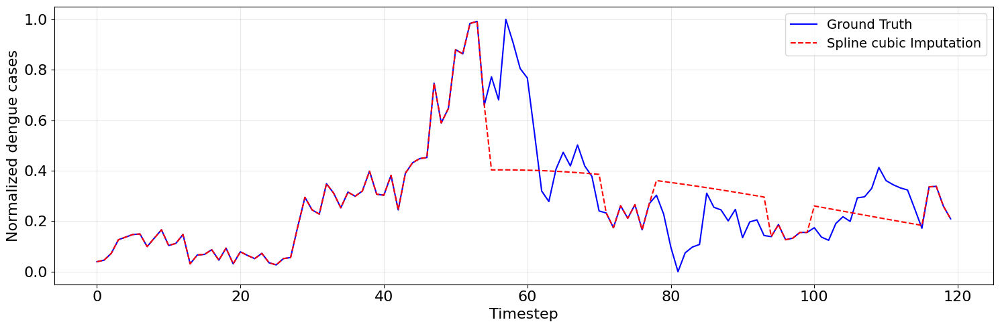

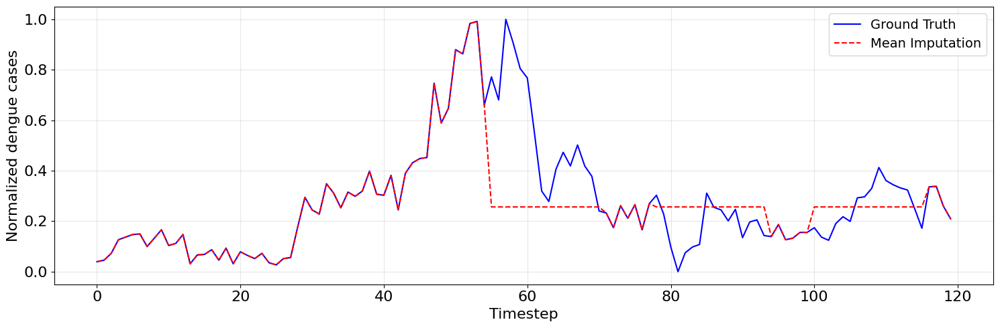

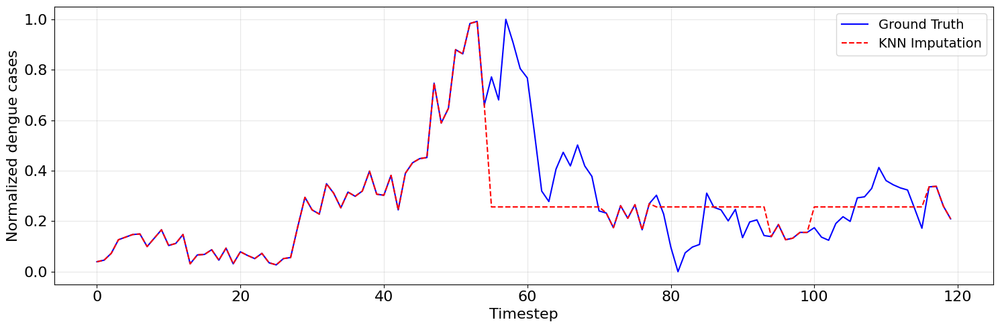

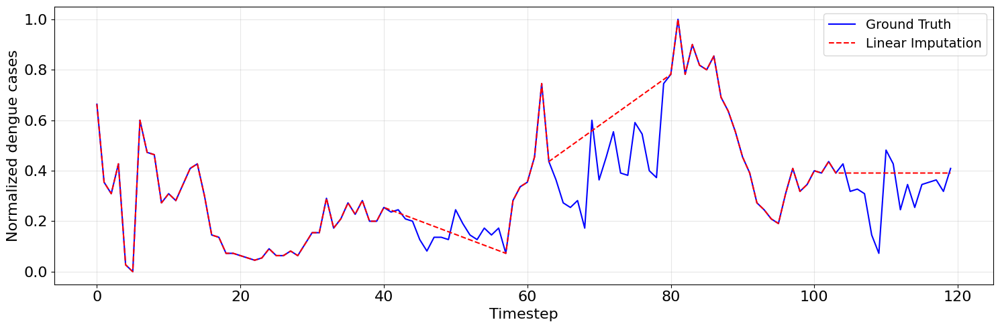

Error with Polynomial (3rd order) on gap_16_trial_4.csv: Input contains NaN.


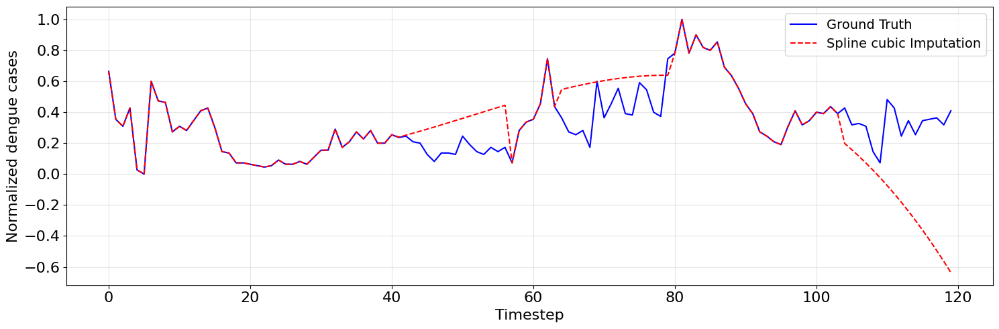

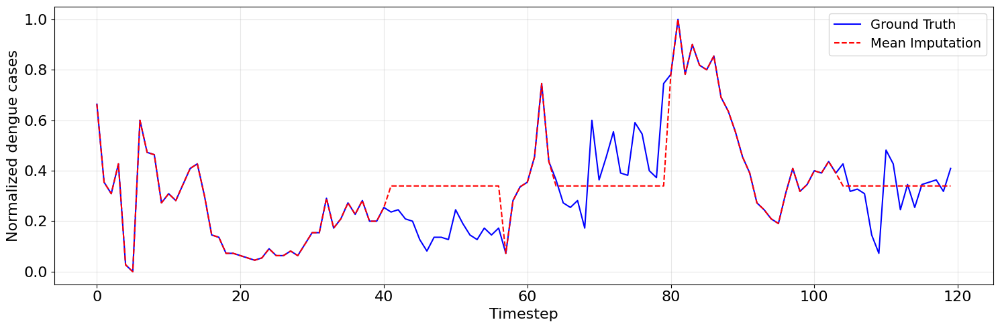

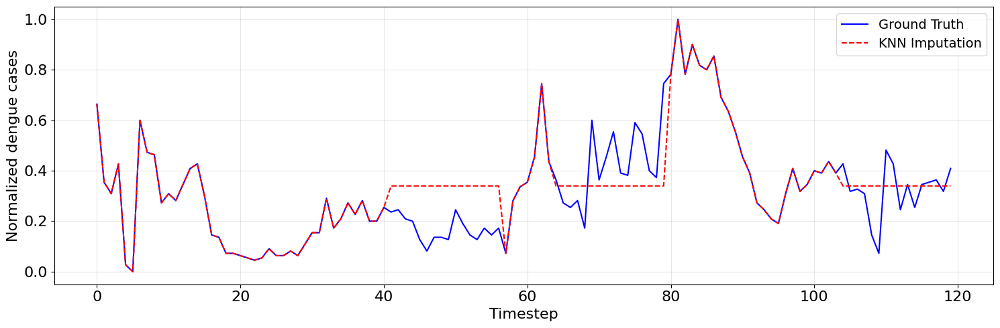

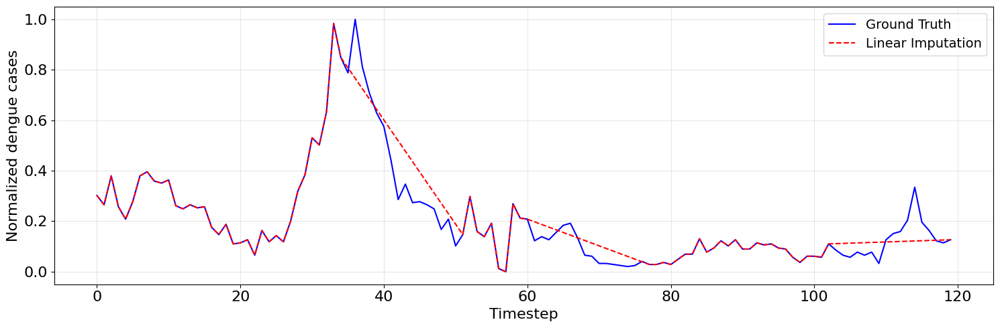

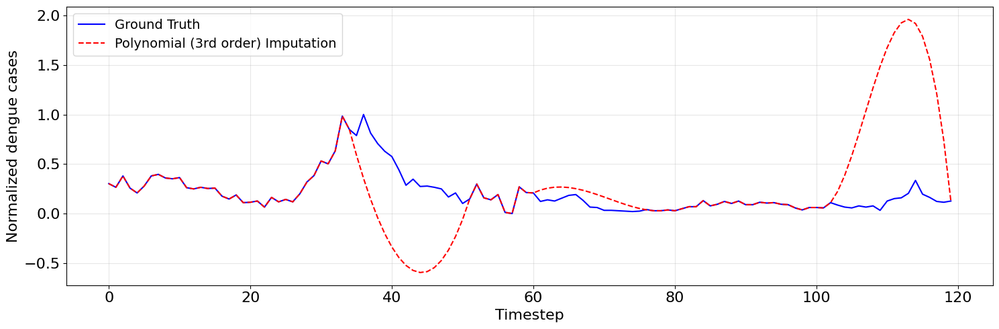

...

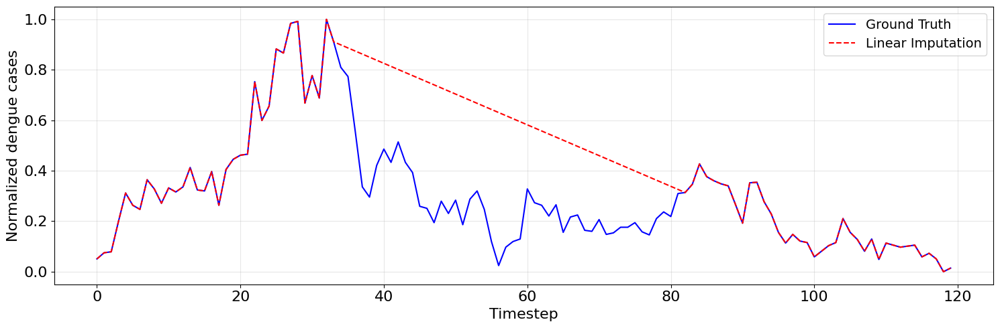

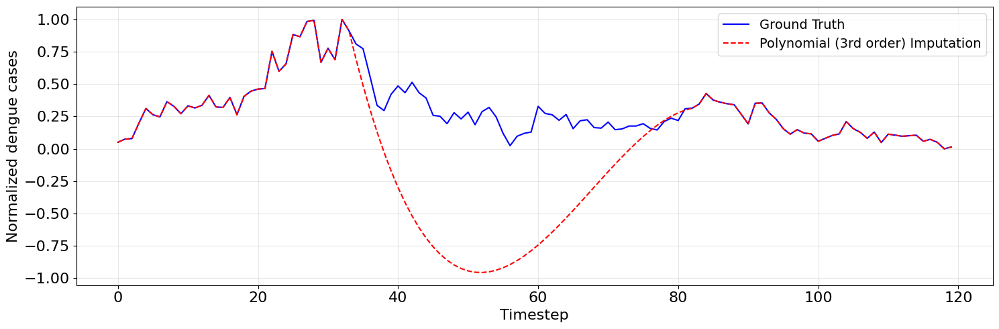

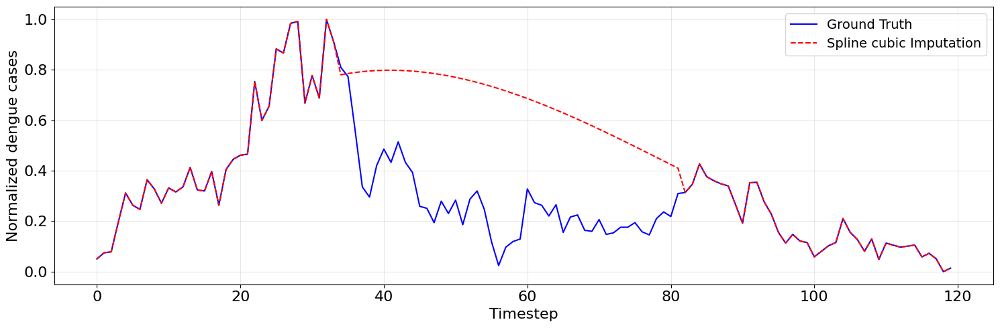

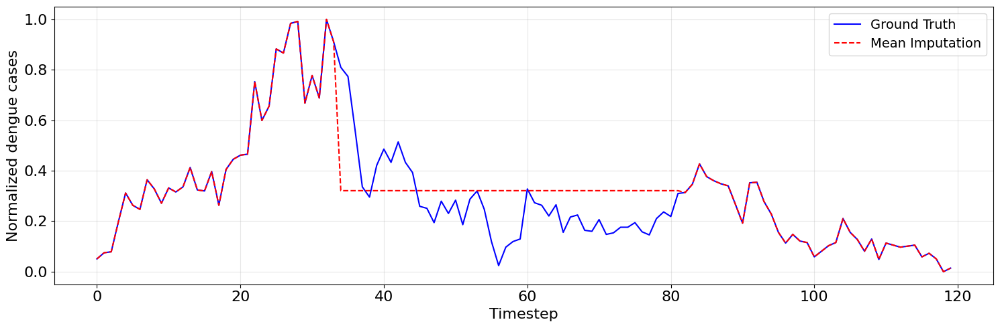

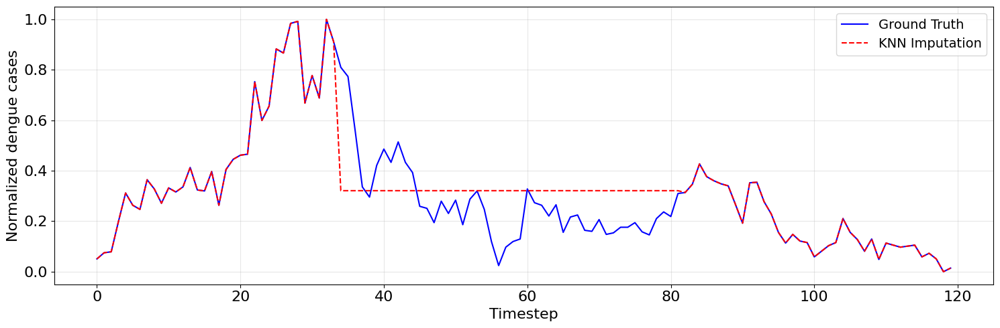

In [ ]:



interp_error_results_all = {}
gan_error_results_all = []


for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)

    #Get data
    ground_truth = df["Ground Truth"].values
    imputed_original = df["Imputed Data"].copy()

    #Find mismatches
    mismatch = ~np.isclose(ground_truth, imputed_original, atol=1e-6)
    mismatch_indices = np.where(mismatch)[0]

    #Extract gap length and trial number from the file name
    gap_length, trial = extract_gap_and_trial(file)

    # --- GAN ERROR ---
    gt_mismatch = ground_truth[mismatch_indices]
    imp_mismatch = imputed_original[mismatch_indices]
    rmse = np.sqrt(np.mean((gt_mismatch - imp_mismatch) ** 2))
    mae = np.mean(np.abs(gt_mismatch - imp_mismatch))
    denominator = (np.abs(gt_mismatch) + np.abs(imp_mismatch))
    nonzero = denominator != 0
    smape = 100 * np.mean(2 * np.abs(gt_mismatch[nonzero] - imp_mismatch[nonzero]) / denominator[nonzero])
    r2 = r2_score(gt_mismatch, imp_mismatch)

    #Append per-trial GAN results
    gan_error_results_all.append({
        'file': file,
        'gap_length': gap_length,
        'trial': trial,
        'rmse': rmse,
        'mae': mae,
        'smape': smape,
        'r2': r2,
    })

    # --- INTERPOLATION METHODS ---
    for method_name, params in interpolation_methods.items():

        try:
            imputed_series = imputed_original.copy()
            imputed_series[mismatch] = np.nan
            imputed_series = pd.Series(imputed_series)

            if method_name == 'Mean':
                imputed_filled = imputed_series.fillna(imputed_series.mean()).values
            elif method_name == 'KNN':
                knn_input = imputed_series.values.reshape(-1, 1)
                imputer = KNNImputer(n_neighbors=3)
                imputed_filled = imputer.fit_transform(knn_input).flatten()
            elif 'order' in params:
                imputed_filled = imputed_series.interpolate(
                    method=params['method'],
                    order=params['order'],
                    limit_direction='both'
                ).values
            else:
                imputed_filled = imputed_series.interpolate(
                    method=params['method'],
                    limit_direction='both'
                ).values

            #Compute error
            gt_mismatch = ground_truth[mismatch_indices]
            imp_mismatch = imputed_filled[mismatch_indices]
            rmse = np.sqrt(np.mean((gt_mismatch - imp_mismatch) ** 2))
            mae = np.mean(np.abs(gt_mismatch - imp_mismatch))
            denominator = (np.abs(gt_mismatch) + np.abs(imp_mismatch))
            nonzero = denominator != 0
            smape = 100 * np.mean(2 * np.abs(gt_mismatch[nonzero] - imp_mismatch[nonzero]) / denominator[nonzero])
            #r2 = 1 - np.sum((gt_mismatch - imp_mismatch) ** 2) / np.sum((gt_mismatch - np.mean(gt_mismatch)) ** 2)
            r2 = r2_score(gt_mismatch, imp_mismatch)

            plt.figure(figsize=(15, 5))
            plt.plot(ground_truth, label='Ground Truth', color='blue')
            #plt.plot(ground_truth, label='With Gaps', color='green', alpha=0.5)
            plt.plot(imputed_filled, label=f"{method_name} Imputation", color='red', linestyle='--')
            plt.xlabel('Timestep', fontsize='16')
            plt.ylabel('Normalized dengue cases', fontsize='16')
            plt.xticks(fontsize=16)
            plt.yticks(fontsize=16)
            plt.grid(alpha=0.3)
            #plt.title(f"Gaps: {gap_length} | Trial: {trial}")
            plt.legend(fontsize=14)
            plt.tight_layout()
            comparison_filename = f'GAN_{method_name}_gap{gap_length}_t{trial}'
            comparison_path = os.path.join(output_dir, comparison_filename + '.png')
            #plt.savefig(comparison_path)
            plt.show()


            #Save results
            if method_name not in interp_error_results_all:
                interp_error_results_all[method_name] = []
            interp_error_results_all[method_name].append({
                'file': file,
                'gap_length': gap_length,
                'trial': trial,
                'rmse': rmse,
                'mae': mae,
                'smape': smape,
                'r2': r2,
                'ground_truth': ground_truth,
                'imputed': imputed_filled
            })

        except Exception as e:
            print(f"Error with {method_name} on {file}: {e}")


In [ ]:
# --- Aggregate GAN results by gap length ---
gan_avg_results = {}
gan_grouped = defaultdict(list)

for result in gan_error_results_all:
    gap = result['gap_length']
    gan_grouped[gap].append(result)

for gap, entries in gan_grouped.items():
    rmse = np.mean([e['rmse'] for e in entries])
    rmse_std = np.std([e['rmse'] for e in entries])
    mae = np.mean([e['mae'] for e in entries])
    mae_std = np.std([e['mae'] for e in entries])
    smape = np.mean([e['smape'] for e in entries])
    smape_std = np.std([e['smape'] for e in entries])
    r2 = np.mean([e['r2'] for e in entries])
    r2_std = np.std([e['r2'] for e in entries])

    gan_avg_results[gap] = {
        'avg_rmse': rmse,
        'std_rmse': rmse_std,
        'avg_mae': mae,
        'std_mae': mae_std,
        'avg_smape': smape,
        'std_smape': smape_std,
        'avg_r2': r2,
        'std_r2': r2_std,
        'num_trials': len(entries)
    }

# --- Aggregate Interpolation results by method and gap length ---
interp_avg_results = {}

for method, results in interp_error_results_all.items():
    grouped = defaultdict(list)
    for result in results:
        grouped[result['gap_length']].append(result)

    method_averages = {}
    for gap, entries in grouped.items():
        rmse = np.nanmean([e['rmse'] for e in entries])
        rmse_std = np.nanstd([e['rmse'] for e in entries])
        mae = np.nanmean([e['mae'] for e in entries])
        mae_std = np.nanstd([e['mae'] for e in entries])
        smape = np.nanmean([e['smape'] for e in entries])
        smape_std = np.nanstd([e['smape'] for e in entries])
        r2 = np.nanmean([e['r2'] for e in entries])
        r2_std = np.nanstd([e['r2'] for e in entries])

        method_averages[gap] = {
            'avg_rmse': rmse,
            'std_rmse': rmse_std,
            'avg_mae': mae,
            'std_mae': mae_std,
            'avg_smape': smape,
            'std_smape': smape_std,
            'avg_r2': r2,
            'std_r2': r2_std,
            'num_trials': len(entries)
        }

    interp_avg_results[method] = method_averages


<ipython-input-8-975d4d890bcc>:2: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('tab10', len(interp_avg_results) + 1)


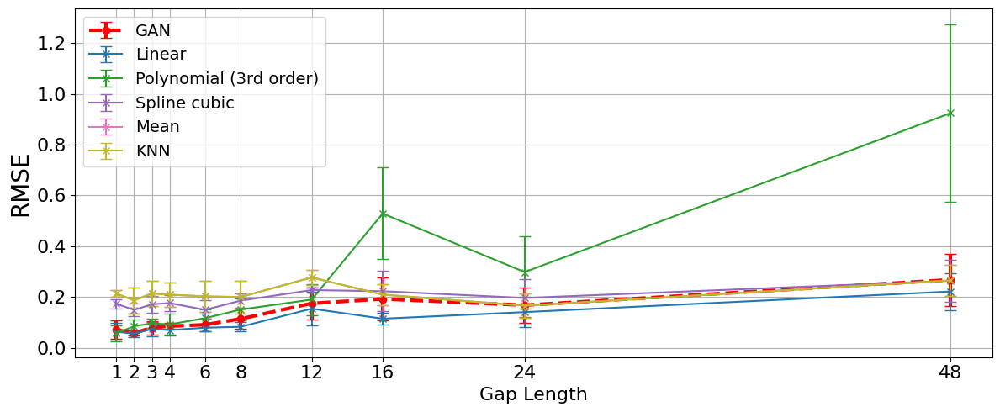

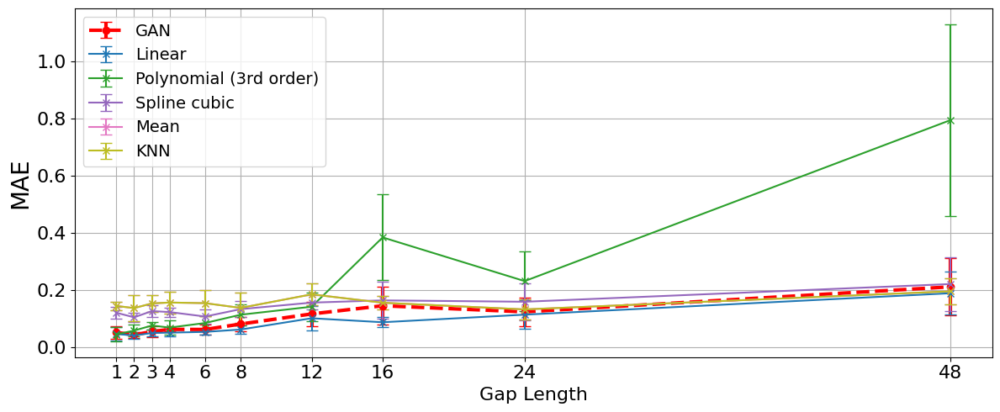

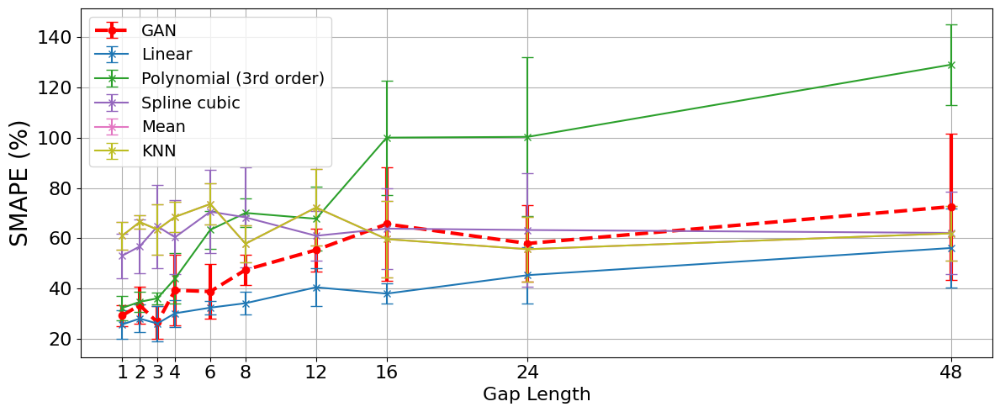

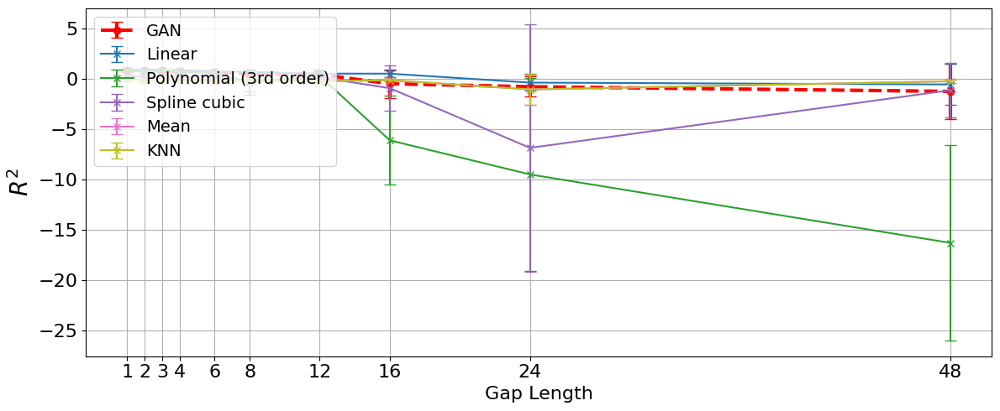

In [ ]:

gap_lengths = sorted(set(gan_avg_results.keys()))
colors = plt.cm.get_cmap('tab10', len(interp_avg_results) + 1)

#Plot settings
error_metrics = ['avg_rmse', 'avg_mae', 'avg_smape', 'avg_r2']
metric_labels = {'avg_rmse': 'RMSE', 'avg_mae': 'MAE', 'avg_smape': 'SMAPE (%)', 'avg_r2' : r'$R^2$'}

for metric in error_metrics:
    std_metric = metric.replace("avg", "std")
    plt.figure(figsize=(12, 5))

    # --- GAN plot with error bars ---
    gan_values = [gan_avg_results[gap][metric] for gap in gap_lengths]
    gan_errors = [gan_avg_results[gap][std_metric] for gap in gap_lengths]
    plt.errorbar(gap_lengths, gan_values, yerr=gan_errors, label='GAN',
                 color='red', linewidth=3, marker='o', capsize=5, linestyle='--')

    # --- Interpolation methods with error bars ---
    for idx, (method, results) in enumerate(interp_avg_results.items()):
        values = [results.get(gap, {}).get(metric, np.nan) for gap in gap_lengths]
        errors = [results.get(gap, {}).get(std_metric, np.nan) for gap in gap_lengths]
        plt.errorbar(gap_lengths, values, yerr=errors, label=method,
                     color=colors(idx), linestyle='-', marker='x', capsize=5)

    #plt.title(f'{metric_labels[metric]} vs Gap Length', fontsize=16)
    plt.xlabel('Gap Length', fontsize=16)
    plt.ylabel(metric_labels[metric], fontsize=20)
    plt.xticks(gap_lengths, fontsize=16)
    plt.yticks(fontsize=16)
    plt.grid(True)
    plt.legend(fontsize=14, loc='upper left')
    plt.tight_layout()
    #plt.savefig(f"GAN_{metric}.png", dpi=300)
    plt.show()


[np.float64(0.07110693192804804), np.float64(0.05842744256866742), np.float64(0.07903234067822311), np.float64(0.08538606224499987), np.float64(0.0909525107474076), np.float64(0.1142516820745992), np.float64(0.17509115833989636), np.float64(0.19234457537262367), np.float64(0.16795103990796836), np.float64(0.26819211316245495)]


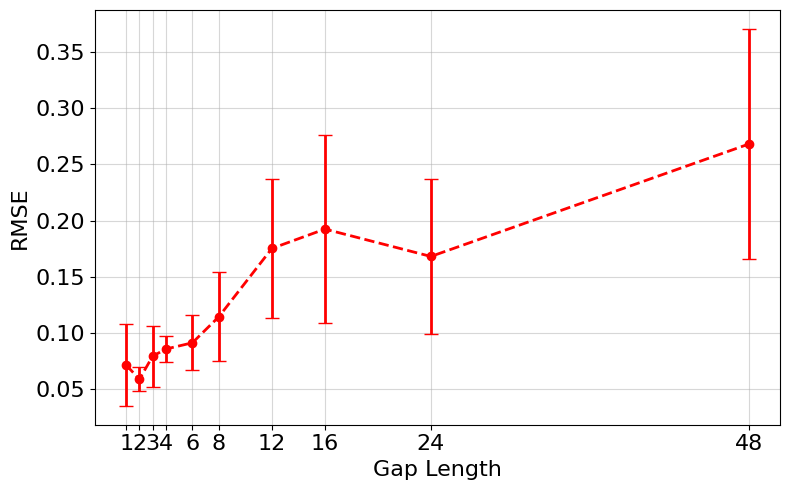

In [ ]:
#Define gap lengths and RMSE values for GAN
gap_lengths = sorted(set(gan_avg_results.keys()))
metric = 'avg_rmse'
std_metric = 'std_rmse'

gan_values = [gan_avg_results[gap][metric] for gap in gap_lengths]
gan_errors = [gan_avg_results[gap][std_metric] for gap in gap_lengths]

print(gan_values)

plt.figure(figsize=(8, 5))
plt.errorbar(gap_lengths, gan_values, yerr=gan_errors, label='GAN',
             color='red', linewidth=2, marker='o', capsize=5, linestyle='--')

plt.xlabel('Gap Length', fontsize=16)
plt.ylabel('RMSE', fontsize=16)
plt.xticks(gap_lengths, fontsize=16)
plt.yticks(fontsize=16)
plt.grid(alpha=0.5)
plt.tight_layout()
plt.savefig("GAN_RMSE_only.png", dpi=300)
plt.show()


# LINFOOTS AND COSINE DISTANCE

In [ ]:
from scipy.fft import fft

angle_comparison_list = []

for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)

    ground_truth = df["Ground Truth"].values
    gan_imputed = df["Imputed Data"].values
    gap_length, trial = extract_gap_and_trial(file)

    # Use GAN to determine mismatch-based segments
    mismatch = ~np.isclose(ground_truth, gan_imputed, atol=1e-6)
    mismatch_indices = np.where(mismatch)[0]
    segments = get_continuous_segments(mismatch_indices)

    method_results = {'GAN': gan_imputed}

    for method_name, params in interpolation_methods.items():
        try:
            imputed_series = df["Ground Truth"].copy()
            imputed_series[mismatch_indices] = np.nan
            imputed_series = pd.Series(imputed_series)

            if method_name == 'Mean':
                imputed_filled = imputed_series.fillna(imputed_series.mean()).values
            elif method_name == 'KNN':
                knn_input = imputed_series.values.reshape(-1, 1)
                imputer = KNNImputer(n_neighbors=3)
                imputed_filled = imputer.fit_transform(knn_input).flatten()
            elif 'order' in params:
                imputed_filled = imputed_series.interpolate(
                    method=params['method'],
                    order=params['order'],
                    limit_direction='both'
                ).values
            else:
                imputed_filled = imputed_series.interpolate(
                    method=params['method'],
                    limit_direction='both'
                ).values

            method_results[method_name] = imputed_filled

        except Exception as e:
            print(f"Error with {method_name} on file {file}: {e}")

    # --- Segment-wise analysis ---
    for segment in segments:
        if len(segment) > 1:
            gt_segment = ground_truth[segment]

            for method_name, imputed_data in method_results.items():
                imp_segment = imputed_data[segment]

                #Time-domain Linfoot
                angle = calculate_angle(gt_segment, imp_segment)
                F, C, Q = calculate_linfoot(gt_segment, imp_segment)

                #Frequency-domain Linfoot (on FFT)
                fft_gt = np.abs(fft(gt_segment - np.mean(gt_segment)))
                fft_imp = np.abs(fft(imp_segment - np.mean(imp_segment)))
                F_fft, C_fft, Q_fft = calculate_linfoot(fft_gt, fft_imp)


                angle_comparison_list.append({
                    'gap': gap_length,
                    'trial': trial,
                    'segment_start': segment[0],
                    'segment_end': segment[-1],
                    'segment_length': len(segment),
                    'method': method_name,
                    'angle': angle,
                    'F': F,
                    'C': C,
                    'Q': Q,
                    'F_fft': F_fft,
                    'C_fft': C_fft,
                    'Q_fft': Q_fft,
                    'fft_gt': fft_gt,
                    'fft_imp': fft_imp
                })

# --- Create DataFrame with full detail (each segment/trial/method) ---
angle_comparison_df = pd.DataFrame(angle_comparison_list)
print("Full segment-level angle data:")
display(angle_comparison_df)


Full segment-level angle data:


,gap,trial,segment_start,segment_end,segment_length,method,angle,F,C,Q,F_fft,C_fft,Q_fft,fft_gt,fft_imp
0,2,1,2,3,2,GAN,0.995152,0.870496,1.799133,1.334814,-2.499612e+04,2.499712e+04,0.000000e+00,"[0.0, 0.0]","[0.0, 0.022359390000000007]"
1,2,1,2,3,2,Linear,0.989415,0.903889,1.596109,1.249998,-4.827695e+04,4.827795e+04,0.000000e+00,"[0.0, 0.0]","[1.3877787807814457e-17, 0.03107344632768362]"
2,2,1,2,3,2,Polynomial (3rd order),0.978973,0.900125,1.489258,1.194691,-8.901131e+04,8.901231e+04,0.000000e+00,"[0.0, 0.0]","[0.0, 0.04219296282562415]"
3,2,1,2,3,2,Spline cubic,0.999982,0.921237,1.639843,1.280540,-8.443251e+01,8.543251e+01,0.000000e+00,"[0.0, 0.0]","[1.3877787807814457e-17, 0.0013071534435894067]"
4,2,1,2,3,2,Mean,1.000000,-1.875847,7.267507,2.695830,1.000000e+00,0.000000e+00,0.000000e+00,"[0.0, 0.0]","[0.0, 0.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2275,48,5,34,81,48,Linear,0.923647,-0.365203,4.110450,1.872624,8.359404e-01,1.196555e+00,1.016248e+00,"[1.2212453270876722e-15, 3.183646157680808, 2....","[4.3298697960381105e-15, 4.472102005892913, 2...."
2276,48,5,34,81,48,Polynomial (3rd order),-0.410076,-5.217816,3.650755,1.414453,-4.335383e+00,8.983839e+00,2.324228e+00,"[1.2212453270876722e-15, 3.183646157680808, 2....","[1.1657341758564144e-15, 15.063799332786362, 3..."
2277,48,5,34,81,48,Spline cubic,0.896600,-0.837468,4.742617,1.952574,8.163926e-01,6.403588e-01,7.283757e-01,"[1.2212453270876722e-15, 3.183646157680808, 2....","[2.0539125955565396e-15, 3.465472336318807, 1...."
2278,48,5,34,81,48,Mean,0.870236,0.733500,1.049683,0.891592,8.745421e-09,1.293548e-31,5.928760e-32,"[1.2212453270876722e-15, 3.183646157680808, 2....","[2.6645352591003757e-15, 0.0, 0.0, 0.0, 0.0, 0..."


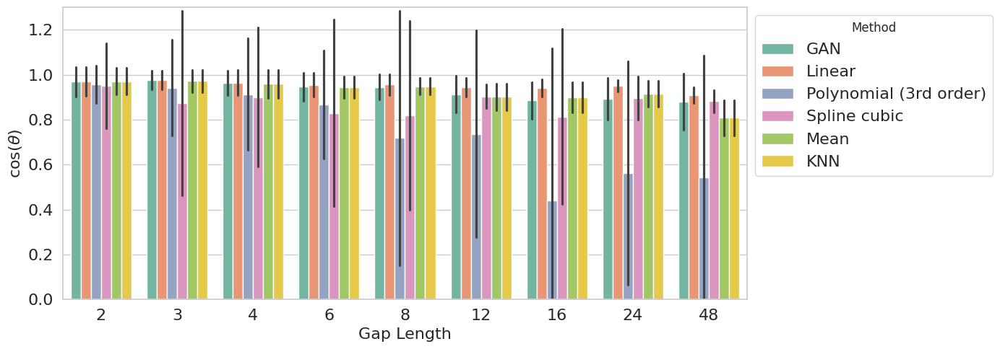

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(14, 5))
sns.barplot(
    data=angle_comparison_df,
    x='gap',
    y='angle',
    hue='method',
    errorbar='sd',
    palette='Set2')

#plt.title('Average cosine similarity per gap length', fontsize=16)
plt.xlabel("Gap Length", fontsize=16)
plt.ylabel(r'cos($\theta$)', fontsize=16)
plt.legend(title="Method", bbox_to_anchor=(1, 1), loc='upper left', fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0, 1.3)
plt.tight_layout()
#plt.savefig('GAN_cosine_distance.png')
plt.show()


In [ ]:

#Compute both mean and std
fcq_mean = angle_comparison_df.groupby(['gap', 'method'])[['F', 'C', 'Q']].mean()
fcq_std = angle_comparison_df.groupby(['gap', 'method'])[['F', 'C', 'Q']].std()

fcq_combined = fcq_mean.reset_index().copy()
for metric in ['F', 'C', 'Q']:
    fcq_combined[f'{metric}_std'] = fcq_std.reset_index()[metric]

metrics = ['F', 'C', 'Q']
markers = {'F': 'o', 'C': 's', 'Q': '^'}
labels = {'F': 'Fidelity', 'C': 'Structural Content', 'Q': 'Correlation Quality'}

for metric in metrics:
    plt.figure(figsize=(10, 6))

    for method in fcq_combined['method'].unique():
        method_data = fcq_combined[fcq_combined['method'] == method]
        plt.errorbar(
            method_data['gap'], method_data[metric],
            yerr=method_data[f'{metric}_std'],
            fmt=markers[metric] + '-', label=method, capsize=5)

    plt.title(f'{labels[metric]}', fontsize=16)
    plt.xlabel('Gap Length', fontsize=16)
    plt.ylabel(metric, fontsize=16)
    plt.legend(title='Method', fontsize=16)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(f'GAN_Linfoot_{metric}.png')
    plt.show()


,gap,trial,segment_start,segment_end,segment_length,method,angle,F,C,Q,F_fft,C_fft,Q_fft,fft_gt,fft_imp
0,2,1,2,3,2,GAN,0.995152,0.870496,1.799133,1.334814,-24996.116059,24997.116059,0.000000,"[0.0, 0.0]","[0.0, 0.022359390000000007]"
1,2,1,2,3,2,Linear,0.989415,0.903889,1.596109,1.249998,-48276.953334,48277.953334,0.000000,"[0.0, 0.0]","[1.3877787807814457e-17, 0.03107344632768362]"
6,2,1,6,7,2,GAN,0.992660,0.985201,0.959511,0.972356,0.130511,0.004560,0.067529,"[0.0, 0.03813559322033899]","[0.0, 0.002575280000000013]"
7,2,1,6,7,2,Linear,0.991976,0.981651,0.889908,0.935779,0.209887,0.012346,0.111110,"[0.0, 0.03813559322033899]","[2.7755575615628914e-17, 0.004237288135593237]"
12,2,1,15,16,2,GAN,0.983540,0.895605,0.512206,0.703906,0.518376,0.093641,0.306008,"[2.7755575615628914e-17, 0.1101694915254238]","[1.3877787807814457e-17, 0.03371275]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2263,48,2,4,51,48,Linear,0.850149,0.715909,0.870275,0.793092,0.719715,0.279299,0.499507,"[9.43689570931383e-16, 5.243578680190773, 4.47...","[3.3306690738754696e-16, 3.6146307684059558, 1..."
2268,48,3,60,107,48,GAN,0.958200,0.845343,0.473863,0.659603,0.658499,0.196093,0.427296,"[7.216449660063518e-16, 7.741085767051111, 4.4...","[1.304512053934559e-15, 3.115514365952032, 2.0..."
2269,48,3,60,107,48,Linear,0.934090,0.852563,0.628543,0.740553,0.583355,0.136003,0.359679,"[7.216449660063518e-16, 7.741085767051111, 4.4...","[1.27675647831893e-15, 2.8010718003274344, 1.4..."
2274,48,5,34,81,48,GAN,0.896681,-0.850176,4.764806,1.957315,0.837761,1.050807,0.944284,"[1.2212453270876722e-15, 3.183646157680808, 2....","[6.106226635438361e-16, 4.264898982393803, 2.2..."


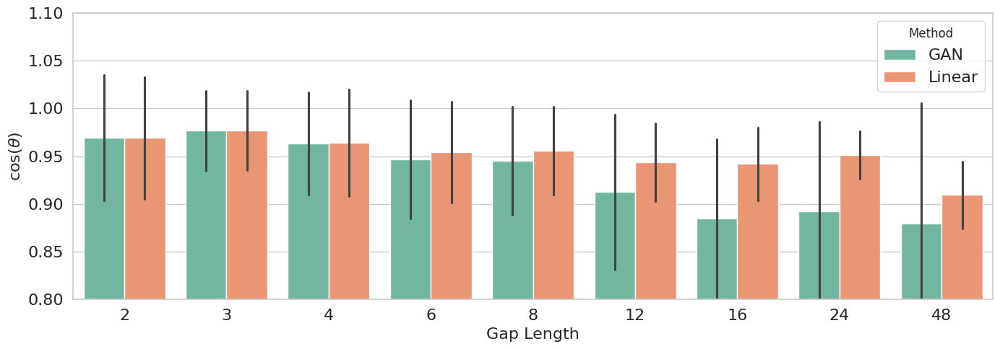

In [ ]:
# Filter the DataFrame to only include rows with 'GAN' and 'Linear' methods
filtered_df = angle_comparison_df.loc[angle_comparison_df['method'].isin(['GAN', 'Linear'])]
display(filtered_df)
# Now create the plot using the filtered DataFrame
sns.set(style="whitegrid")
plt.figure(figsize=(14, 5))
sns.barplot(
    data=filtered_df,
    x='gap',
    y='angle',
    hue='method',
    errorbar='sd',
    palette='Set2')  # Use Seaborn's default 'Set2' palette

plt.xlabel("Gap Length", fontsize=16)
plt.ylabel(r'cos($\theta$)', fontsize=16)
plt.legend(title="Method", loc='upper right', fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.8, 1.1)
plt.tight_layout()
plt.savefig('GANlinear_cosine_distance.png')
plt.show()


In [ ]:
fcq_mean = angle_comparison_df.groupby(['gap', 'method'])[['F', 'C', 'Q']].mean()
fcq_std = angle_comparison_df.groupby(['gap', 'method'])[['F', 'C', 'Q']].std()

#Merge mean and std
fcq_combined = fcq_mean.reset_index().copy()
for metric in ['F', 'C', 'Q']:
    fcq_combined[f'{metric}_std'] = fcq_std.reset_index()[metric]

#Only plot these methods
methods_to_plot = ['GAN', 'Linear']

metrics = ['F', 'C', 'Q']
markers = {'F': 'o', 'C': 's', 'Q': '^'}
labels = {'F': 'Fidelity', 'C': 'Structural Content', 'Q': 'Correlation Quality'}

for metric in metrics:
    plt.figure(figsize=(14, 6))

    for method in methods_to_plot:
        method_data = fcq_combined[fcq_combined['method'] == method]
        plt.errorbar(
            method_data['gap'], method_data[metric],
            yerr=method_data[f'{metric}_std'],
            fmt=markers[metric] + '-', label=method, capsize=5)

    #plt.title(f'{labels[metric]}', fontsize=16)
    plt.xlabel('Gap Length', fontsize=16)
    plt.ylabel(f'{labels[metric]} {metric}', fontsize=16)
    plt.legend(title='Method', fontsize=16, loc='upper right')
    plt.xticks(method_data['gap'], fontsize=16)
    plt.yticks(fontsize=16)
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(f'GANLinear_Linfoot_{metric}.png')
    plt.show()


In [ ]:
for metric in metrics:
    plt.figure(figsize=(14, 6))

    for method in methods_to_plot:
        method_data = fcq_combined[fcq_combined['method'] == method].copy()
        method_data['gap'] = pd.to_numeric(method_data['gap'], errors='coerce')
        method_data = method_data.sort_values(by='gap')

        plt.errorbar(
            method_data['gap'], method_data[metric],
            yerr=method_data[f'{metric}_std'],
            fmt=markers[metric] + '-', label=method, capsize=5)

    plt.title(f'{labels[metric]}', fontsize=16)
    plt.xlabel('Gap Length', fontsize=16)
    plt.ylabel(metric, fontsize=16)
    plt.legend(title='Method', loc='upper right', fontsize=16)
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    plt.grid(True)
    plt.tight_layout()
    plt.savefig(f'GANLinear_Linfoot_{metric}.png')
    plt.show()


# Thesis comparison plots

In [ ]:


#Loop through each CSV file and plot
for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)

    #Assuming these columns exist in the CSV
    ground_truth = df['Ground Truth']
    imputed_filled = df['Imputed Data']

    gap_length, trial = extract_gap_and_trial(file)

    if gap_length == 4:
      #Plotting
      plt.figure(figsize=(8, 5))
      plt.plot(ground_truth, label='Ground Truth', color='blue')
      plt.plot(imputed_filled, label=f"GAN Imputation", color='red', linestyle='--')
      plt.xlabel('Timestep', fontsize=16)
      plt.ylabel('Normalized dengue cases', fontsize=16)
      plt.xticks(fontsize=16)
      plt.yticks(fontsize=16)
      plt.grid(alpha=0.3)
      #plt.title(f" Gaps: {gap_length} | Trial: {trial}")
      #plt.title(f" Gap Length: {gap_length}", fontsize=16)
      plt.legend(fontsize=14)
      plt.tight_layout()
      comparison_filename = f'GANcomparison_gap{gap_length}_t{trial}'
      comparison_path = os.path.join(output_dir, comparison_filename + '.png')
      plt.savefig(comparison_path)
      plt.show()


In [ ]:


for file in csv_files:
    file_path = os.path.join(folder_path, file)
    df = pd.read_csv(file_path)

    #Get data
    ground_truth = df["Ground Truth"].values
    imputed_original = df["Imputed Data"].copy()

    #Find mismatches
    mismatch = ~np.isclose(ground_truth, imputed_original, atol=1e-6)
    mismatch_indices = np.where(mismatch)[0]

    #Extract gap length and trial number from the file name
    gap_length, trial = extract_gap_and_trial(file)

    if gap_length == 4:

      # --- INTERPOLATION METHODS ---
      for method_name, params in interpolation_methods.items():

          try:
              imputed_series = imputed_original.copy()
              imputed_series[mismatch] = np.nan
              imputed_series = pd.Series(imputed_series)

              if method_name == 'Mean':
                  imputed_filled = imputed_series.fillna(imputed_series.mean()).values
              elif method_name == 'KNN':
                  knn_input = imputed_series.values.reshape(-1, 1)
                  imputer = KNNImputer(n_neighbors=3)
                  imputed_filled = imputer.fit_transform(knn_input).flatten()
              elif 'order' in params:
                  imputed_filled = imputed_series.interpolate(
                      method=params['method'],
                      order=params['order'],
                      limit_direction='both'
                  ).values
              else:
                  imputed_filled = imputed_series.interpolate(
                      method=params['method'],
                      limit_direction='both'
                  ).values


              plt.figure(figsize=(8, 5))
              plt.plot(ground_truth, label='Ground Truth', color='blue')
              #plt.plot(ground_truth, label='With Gaps', color='green', alpha=0.5)
              plt.plot(imputed_filled, label=f"{method_name} Imputation", color='red', linestyle='--')
              plt.xlabel('Timestep', fontsize='16')
              plt.ylabel('Normalized dengue cases', fontsize='16')
              plt.xticks(fontsize=16)
              plt.yticks(fontsize=16)
              plt.grid(alpha=0.3)
              #plt.title(f"Gaps: {gap_length} | Trial: {trial}")
              plt.legend(fontsize=14)
              plt.tight_layout()
              comparison_filename = f'GANcomparison_{method_name}_gap{gap_length}_t{trial}'
              comparison_path = os.path.join(output_dir, comparison_filename + '.png')
              plt.savefig(comparison_path)
              plt.show()



          except Exception as e:
              print(f"Error with {method_name} on {file}: {e}")


# GAN loss

In [ ]:
#Data
folder_path = "/content/drive/My Drive/IPL-VIP/GAN Plots/SPP/GAN_losses_all.xlsx"
sheet_name = ['Iteration_18', 'Iteration_41']


for num, sheet in enumerate(sheet_name):
  data = pd.read_excel(folder_path, sheet_name=sheet)
  plt.figure(figsize=(8, 5))
  plt.plot(data['Step'], data['Discriminator Loss'])
  plt.plot(data['Step'], data['Generator Loss'])
  plt.xlabel('Iterations', fontsize=16)
  plt.ylabel('Loss', fontsize=16)
  plt.xticks(fontsize=16)
  plt.yticks(fontsize=16)
  plt.legend(['Discriminator Loss', 'Generator Loss'], fontsize=16)
  plt.grid(alpha=0.3)
  plt.tight_layout()
  comparison_filename = f'GAN_epochloss_{num}'
  comparison_path = os.path.join(output_dir, comparison_filename + '.png')
  plt.savefig(comparison_path)
  plt.show()
